In [2]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os, sys, glob
import cartopy.crs as ccrs # use cartopy for maps
import matplotlib.path as mpath
import datetime as dt
import cartopy.feature as cfeature # for coastlines

In [3]:
# scenario ssp2-45

ssp245_ar_25_34 = xr.open_dataset(r"data\arctic\ssp245\CM61-LR-scen-ssp245_20250101_20341231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp245_ar_55_64 = xr.open_dataset(r"data\arctic\ssp245\CM61-LR-scen-ssp245_20550101_20641231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp245_ar_85_94 = xr.open_dataset(r"data\arctic\ssp245\CM61-LR-scen-ssp245_20850101_20941231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")

ssp245_eu_25_34 = xr.open_dataset(r"data\europe\ssp245\CM61-LR-scen-ssp245_20250101_20341231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp245_eu_55_64 = xr.open_dataset(r"data\europe\ssp245\CM61-LR-scen-ssp245_20550101_20641231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp245_eu_85_94 = xr.open_dataset(r"data\europe\ssp245\CM61-LR-scen-ssp245_20850101_20941231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")

# FIX: apply rename + datetime conversion directly
def fix_time(ds):
    ds = ds.rename({'time_counter': 'time'})
    ds = ds.assign_coords(time=pd.to_datetime(ds['time'].values))
    return ds

ssp245_ar_25_34 = fix_time(ssp245_ar_25_34)
ssp245_ar_55_64 = fix_time(ssp245_ar_55_64)     
ssp245_ar_85_94 = fix_time(ssp245_ar_85_94)

ssp245_eu_25_34 = fix_time(ssp245_eu_25_34)
ssp245_eu_55_64 = fix_time(ssp245_eu_55_64)     
ssp245_eu_85_94 = fix_time(ssp245_eu_85_94)


In [4]:
# scenario ssp2-85

ssp585_ar_25_34 = xr.open_dataset(r"data\arctic\ssp585\CM61-LR-scen-ssp585_20250101_20341231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp585_ar_55_64 = xr.open_dataset(r"data\arctic\ssp585\CM61-LR-scen-ssp585_20550101_20641231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")
ssp585_ar_85_94 = xr.open_dataset(r"data\arctic\ssp585\CM61-LR-scen-ssp585_20850101_20941231_1M_histmth_arctic_CLEANED.nc",  engine="h5netcdf")

ssp585_eu_25_34 = xr.open_dataset(r"data\europe\ssp585\CM61-LR-scen-ssp585_20250101_20341231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp585_eu_55_64 = xr.open_dataset(r"data\europe\ssp585\CM61-LR-scen-ssp585_20550101_20641231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
ssp585_eu_85_94 = xr.open_dataset(r"data\europe\ssp585\CM61-LR-scen-ssp585_20850101_20941231_1M_histmth_europe_CLEANED.nc",  engine="h5netcdf")
# FIX: apply rename + datetime conversion directly
def fix_time(ds):
    ds = ds.rename({'time_counter': 'time'})
    ds = ds.assign_coords(time=pd.to_datetime(ds['time'].values))
    return ds

ssp585_ar_25_34 = fix_time(ssp585_ar_25_34)
ssp585_ar_55_64 = fix_time(ssp585_ar_55_64)     
ssp585_ar_85_94 = fix_time(ssp585_ar_85_94)

ssp585_eu_25_34 = fix_time(ssp585_eu_25_34)
ssp585_eu_55_64 = fix_time(ssp585_eu_55_64)     
ssp585_eu_85_94 = fix_time(ssp585_eu_85_94)

In [5]:
ssp245_ar_25_34

<xarray.Dataset> Size: 4MB
Dimensions:        (time: 120, lat: 27, lon: 144)
Coordinates:
  * time           (time) datetime64[ns] 960B 2025-01-16T12:00:00 ... 2034-12...
  * lat            (lat) float32 108B 90.0 88.73 87.46 ... 59.58 58.31 57.04
  * lon            (lon) float32 576B -180.0 -177.5 -175.0 ... 172.5 175.0 177.5
    time_instant   (time) datetime64[ns] 960B ...
    time_centered  (time) datetime64[ns] 960B ...
Data variables:
    t2m            (time, lat, lon) float32 2MB ...
    sicf           (time, lat, lon) float32 2MB ...
Attributes:
    name:                      histmth
    description:               Created by xios
    title:                     Created by xios
    Conventions:               CF-1.6
    timeStamp:                 2018-Dec-06 07:53:05 GMT
    uuid:                      ed30e218-6892-487a-90db-c6942fb038bf
    LongName:                  IPSLCM6.1.8-LR
    history:                   Fri Dec  7 02:43:11 2018: ncrcat -C --buffer_s...
    NCO:                       "4.6.0"
    nco_openmp_thread_number:  1

In [61]:
ssp585_ar_25_34

<xarray.Dataset> Size: 4MB
Dimensions:        (time: 120, lat: 27, lon: 144)
Coordinates:
  * time           (time) datetime64[ns] 960B 2025-01-16T12:00:00 ... 2034-12...
  * lat            (lat) float32 108B 90.0 88.73 87.46 ... 59.58 58.31 57.04
  * lon            (lon) float32 576B -180.0 -177.5 -175.0 ... 172.5 175.0 177.5
    time_instant   (time) datetime64[ns] 960B ...
    time_centered  (time) datetime64[ns] 960B ...
Data variables:
    t2m            (time, lat, lon) float32 2MB ...
    sicf           (time, lat, lon) float32 2MB ...
Attributes:
    name:                      histmth
    description:               Created by xios
    title:                     Created by xios
    Conventions:               CF-1.6
    timeStamp:                 2018-Dec-19 15:24:20 GMT
    uuid:                      134e918a-ee2e-4183-92bd-7de0c6144b1f
    LongName:                  IPSLCM6.1.8-LR
    history:                   Thu Dec 20 07:22:53 2018: ncrcat -C --buffer_s...
    NCO:                       "4.6.0"
    nco_openmp_thread_number:  1

### Global analysis

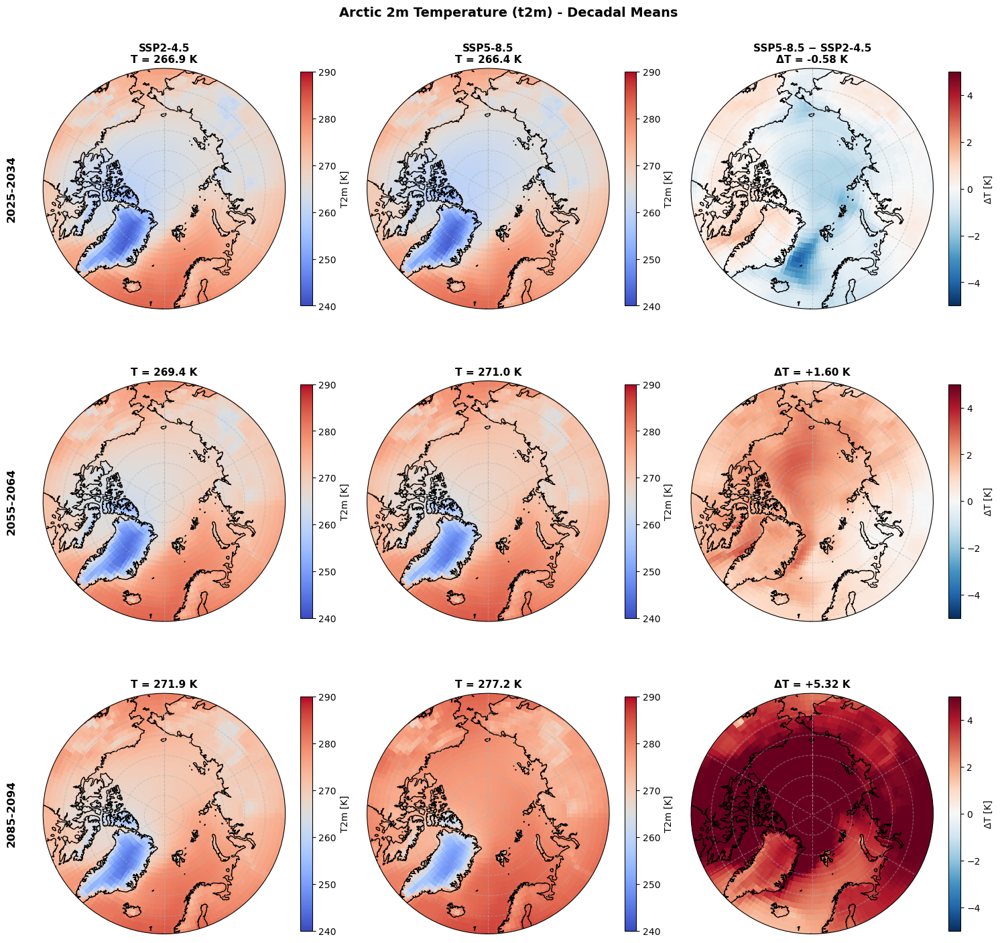

In [ ]:
# ============================================================
# ARCTIC FIGURE (3x3): North Polar Stereographic with circular boundary
# ============================================================

# Compute decadal means for t2m
ssp245_ar_25_mean = ssp245_ar_25_34['t2m'].mean(dim='time')
ssp245_ar_55_mean = ssp245_ar_55_64['t2m'].mean(dim='time')
ssp245_ar_85_mean = ssp245_ar_85_94['t2m'].mean(dim='time')

ssp585_ar_25_mean = ssp585_ar_25_34['t2m'].mean(dim='time')
ssp585_ar_55_mean = ssp585_ar_55_64['t2m'].mean(dim='time')
ssp585_ar_85_mean = ssp585_ar_85_94['t2m'].mean(dim='time')

# Differences
diff_ar_25 = ssp585_ar_25_mean - ssp245_ar_25_mean
diff_ar_55 = ssp585_ar_55_mean - ssp245_ar_55_mean
diff_ar_85 = ssp585_ar_85_mean - ssp245_ar_85_mean

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar, axes_ar = plt.subplots(3, 3, figsize=(15, 15),
                                subplot_kw={'projection': ccrs.NorthPolarStereo()})

# Data layout: rows = decades, cols = [SSP245, SSP585, Difference]
arctic_data = [
    [ssp245_ar_25_mean, ssp585_ar_25_mean, diff_ar_25],
    [ssp245_ar_55_mean, ssp585_ar_55_mean, diff_ar_55],
    [ssp245_ar_85_mean, ssp585_ar_85_mean, diff_ar_85],
]
row_labels = ['2025-2034', '2055-2064', '2085-2094']
col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']

for i, row in enumerate(arctic_data):
    for j, data in enumerate(row):
        ax = axes_ar[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        spatial_mean = float(data.mean())
        
        # Use different colormap for difference
        if j == 2:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-5, vmax=5)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=240, vmax=290)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar.suptitle('Arctic 2m Temperature (t2m) - Decadal Means', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_t2m_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

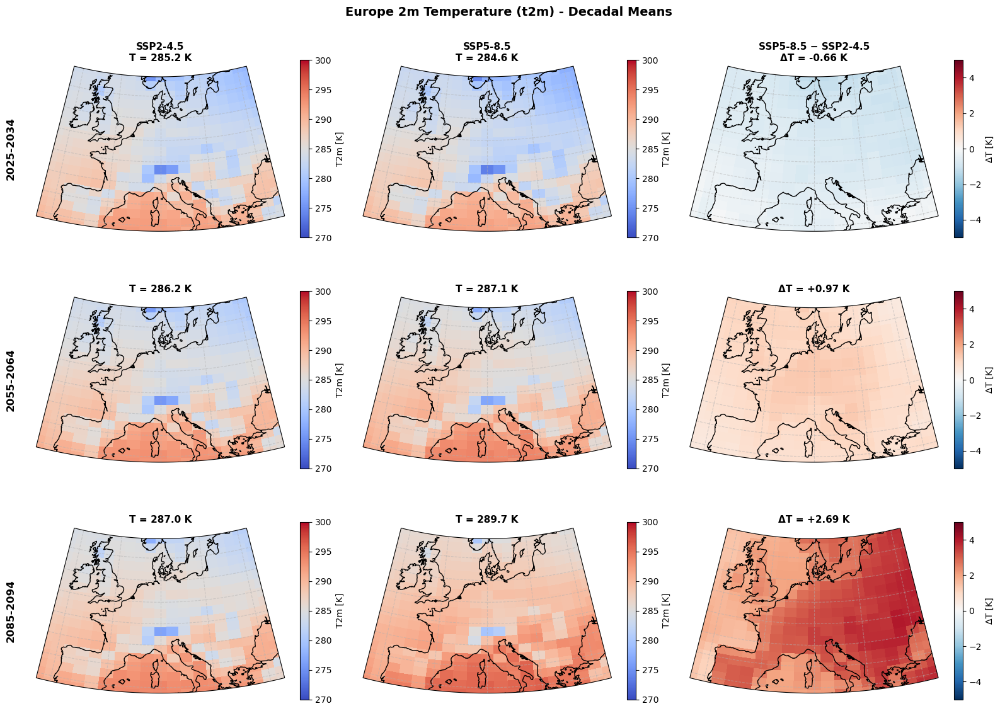

In [ ]:
# ============================================================
# EUROPE FIGURE (3x3): with data-edge boundary
# ============================================================

ssp245_eu_25_mean = ssp245_eu_25_34['t2m'].mean(dim='time')
ssp245_eu_55_mean = ssp245_eu_55_64['t2m'].mean(dim='time')
ssp245_eu_85_mean = ssp245_eu_85_94['t2m'].mean(dim='time')

ssp585_eu_25_mean = ssp585_eu_25_34['t2m'].mean(dim='time')
ssp585_eu_55_mean = ssp585_eu_55_64['t2m'].mean(dim='time')
ssp585_eu_85_mean = ssp585_eu_85_94['t2m'].mean(dim='time')

diff_eu_25 = ssp585_eu_25_mean - ssp245_eu_25_mean
diff_eu_55 = ssp585_eu_55_mean - ssp245_eu_55_mean
diff_eu_85 = ssp585_eu_85_mean - ssp245_eu_85_mean

# Get data bounds
lon_min = float(ssp245_eu_25_mean.lon.min())
lon_max = float(ssp245_eu_25_mean.lon.max())
lat_min = float(ssp245_eu_25_mean.lat.min())
lat_max = float(ssp245_eu_25_mean.lat.max())

# Create boundary path from data edges (in projection coordinates)
proj = ccrs.LambertConformal(central_longitude=(lon_min+lon_max)/2)

# Build polygon vertices around data boundary
n_points = 50
bottom = np.column_stack([np.linspace(lon_min, lon_max, n_points), np.full(n_points, lat_min)])
right = np.column_stack([np.full(n_points, lon_max), np.linspace(lat_min, lat_max, n_points)])
top = np.column_stack([np.linspace(lon_max, lon_min, n_points), np.full(n_points, lat_max)])
left = np.column_stack([np.full(n_points, lon_min), np.linspace(lat_max, lat_min, n_points)])

boundary_lonlat = np.vstack([bottom, right, top, left])

# Transform to projection coordinates
boundary_proj = proj.transform_points(ccrs.PlateCarree(), boundary_lonlat[:, 0], boundary_lonlat[:, 1])
boundary_proj = boundary_proj[:, :2]  # drop z

# Normalize to [0, 1] range for ax.transAxes
x_min, x_max = boundary_proj[:, 0].min(), boundary_proj[:, 0].max()
y_min, y_max = boundary_proj[:, 1].min(), boundary_proj[:, 1].max()
boundary_norm = np.column_stack([
    (boundary_proj[:, 0] - x_min) / (x_max - x_min),
    (boundary_proj[:, 1] - y_min) / (y_max - y_min)
])

data_boundary = mpath.Path(boundary_norm)

fig_eu, axes_eu = plt.subplots(3, 3, figsize=(16, 12),
                                subplot_kw={'projection': proj})

europe_data = [
    [ssp245_eu_25_mean, ssp585_eu_25_mean, diff_eu_25],
    [ssp245_eu_55_mean, ssp585_eu_55_mean, diff_eu_55],
    [ssp245_eu_85_mean, ssp585_eu_85_mean, diff_eu_85],
]
row_labels = ['2025-2034', '2055-2064', '2085-2094']
col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']

for i, row in enumerate(europe_data):
    for j, data in enumerate(row):
        ax = axes_eu[i, j]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], ccrs.PlateCarree())
        ax.set_boundary(data_boundary, transform=ax.transAxes)
        
        # Compute spatial mean for title
        spatial_mean = float(data.mean())
        
        if j == 2:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-5, vmax=5)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=270, vmax=300)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(draw_labels=False, linestyle='--', alpha=0.5)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.12, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_eu.suptitle('Europe 2m Temperature (t2m) - Decadal Means', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacialeurope_t2m_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

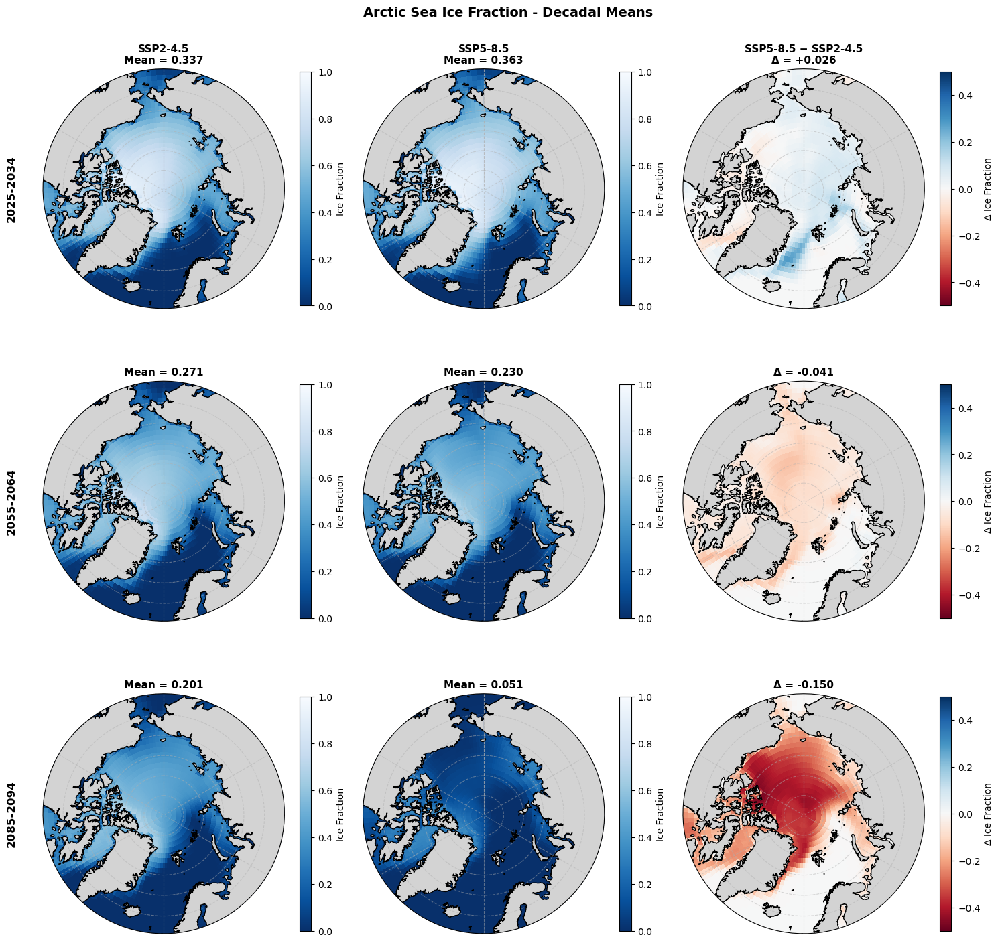

In [ ]:
# ============================================================
# ARCTIC FIGURE (3x3): Sea Ice Fraction - North Polar Stereographic
# ============================================================

ice_var = 'sicf'

ssp245_ar_25_ice = ssp245_ar_25_34[ice_var].mean(dim='time')
ssp245_ar_55_ice = ssp245_ar_55_64[ice_var].mean(dim='time')
ssp245_ar_85_ice = ssp245_ar_85_94[ice_var].mean(dim='time')

ssp585_ar_25_ice = ssp585_ar_25_34[ice_var].mean(dim='time')
ssp585_ar_55_ice = ssp585_ar_55_64[ice_var].mean(dim='time')
ssp585_ar_85_ice = ssp585_ar_85_94[ice_var].mean(dim='time')

# Differences
diff_ar_25_ice = ssp585_ar_25_ice - ssp245_ar_25_ice
diff_ar_55_ice = ssp585_ar_55_ice - ssp245_ar_55_ice
diff_ar_85_ice = ssp585_ar_85_ice - ssp245_ar_85_ice

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar_ice, axes_ar_ice = plt.subplots(3, 3, figsize=(15, 15),
                                        subplot_kw={'projection': ccrs.NorthPolarStereo()})

arctic_ice_data = [
    [ssp245_ar_25_ice, ssp585_ar_25_ice, diff_ar_25_ice],
    [ssp245_ar_55_ice, ssp585_ar_55_ice, diff_ar_55_ice],
    [ssp245_ar_85_ice, ssp585_ar_85_ice, diff_ar_85_ice],
]
row_labels = ['2025-2034', '2055-2064', '2085-2094']
col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']

for i, row in enumerate(arctic_ice_data):
    for j, data in enumerate(row):
        ax = axes_ar_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        spatial_mean = float(data.mean())
        
        if j == 2:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.5, vmax=0.5)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar_ice.suptitle('Arctic Sea Ice Fraction - Decadal Means', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

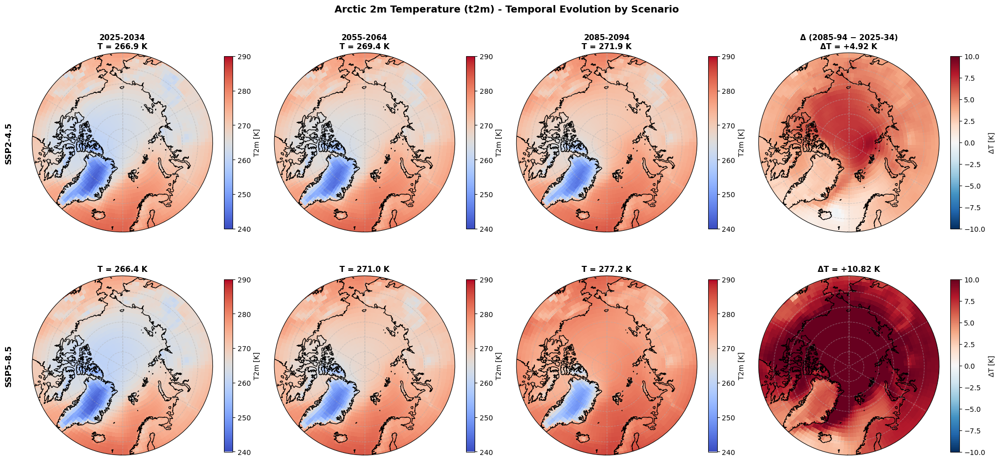

In [ ]:
# ============================================================
# ARCTIC T2M (2x4): Rows = scenarios, Cols = decades + temporal difference
# ============================================================

# Compute decadal means for t2m
ssp245_ar_25_mean = ssp245_ar_25_34['t2m'].mean(dim='time')
ssp245_ar_55_mean = ssp245_ar_55_64['t2m'].mean(dim='time')
ssp245_ar_85_mean = ssp245_ar_85_94['t2m'].mean(dim='time')

ssp585_ar_25_mean = ssp585_ar_25_34['t2m'].mean(dim='time')
ssp585_ar_55_mean = ssp585_ar_55_64['t2m'].mean(dim='time')
ssp585_ar_85_mean = ssp585_ar_85_94['t2m'].mean(dim='time')

# Temporal differences (2085-2094 minus 2025-2034) for each scenario
diff_ar_245_temporal = ssp245_ar_85_mean - ssp245_ar_25_mean
diff_ar_585_temporal = ssp585_ar_85_mean - ssp585_ar_25_mean

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar, axes_ar = plt.subplots(2, 4, figsize=(20, 10),
                                subplot_kw={'projection': ccrs.NorthPolarStereo()})

# Data layout: rows = scenarios, cols = [2025-34, 2055-64, 2085-94, Δ(2085-2025)]
arctic_data = [
    [ssp245_ar_25_mean, ssp245_ar_55_mean, ssp245_ar_85_mean, diff_ar_245_temporal],
    [ssp585_ar_25_mean, ssp585_ar_55_mean, ssp585_ar_85_mean, diff_ar_585_temporal],
]
row_labels = ['SSP2-4.5', 'SSP5-8.5']
col_labels = ['2025-2034', '2055-2064', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, row in enumerate(arctic_data):
    for j, data in enumerate(row):
        ax = axes_ar[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        spatial_mean = float(data.mean())
        
        if j == 3:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-10, vmax=10)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=240, vmax=290)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar.suptitle('Arctic 2m Temperature (t2m) - Temporal Evolution by Scenario', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_t2m_temporal_evolution.png', dpi=150, bbox_inches='tight')
plt.show()

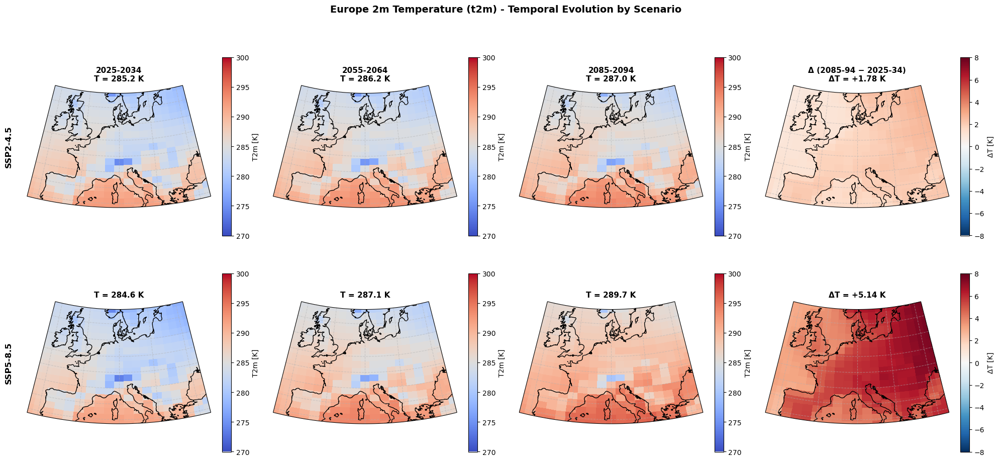

In [ ]:
# ============================================================
# EUROPE T2M (2x4): Rows = scenarios, Cols = decades + temporal difference
# ============================================================

ssp245_eu_25_mean = ssp245_eu_25_34['t2m'].mean(dim='time')
ssp245_eu_55_mean = ssp245_eu_55_64['t2m'].mean(dim='time')
ssp245_eu_85_mean = ssp245_eu_85_94['t2m'].mean(dim='time')

ssp585_eu_25_mean = ssp585_eu_25_34['t2m'].mean(dim='time')
ssp585_eu_55_mean = ssp585_eu_55_64['t2m'].mean(dim='time')
ssp585_eu_85_mean = ssp585_eu_85_94['t2m'].mean(dim='time')

# Temporal differences
diff_eu_245_temporal = ssp245_eu_85_mean - ssp245_eu_25_mean
diff_eu_585_temporal = ssp585_eu_85_mean - ssp585_eu_25_mean

# Get data bounds
lon_min = float(ssp245_eu_25_mean.lon.min())
lon_max = float(ssp245_eu_25_mean.lon.max())
lat_min = float(ssp245_eu_25_mean.lat.min())
lat_max = float(ssp245_eu_25_mean.lat.max())

# Create boundary path
proj = ccrs.LambertConformal(central_longitude=(lon_min+lon_max)/2)
n_points = 50
bottom = np.column_stack([np.linspace(lon_min, lon_max, n_points), np.full(n_points, lat_min)])
right = np.column_stack([np.full(n_points, lon_max), np.linspace(lat_min, lat_max, n_points)])
top = np.column_stack([np.linspace(lon_max, lon_min, n_points), np.full(n_points, lat_max)])
left = np.column_stack([np.full(n_points, lon_min), np.linspace(lat_max, lat_min, n_points)])
boundary_lonlat = np.vstack([bottom, right, top, left])
boundary_proj = proj.transform_points(ccrs.PlateCarree(), boundary_lonlat[:, 0], boundary_lonlat[:, 1])
boundary_proj = boundary_proj[:, :2]
x_min, x_max = boundary_proj[:, 0].min(), boundary_proj[:, 0].max()
y_min, y_max = boundary_proj[:, 1].min(), boundary_proj[:, 1].max()
boundary_norm = np.column_stack([
    (boundary_proj[:, 0] - x_min) / (x_max - x_min),
    (boundary_proj[:, 1] - y_min) / (y_max - y_min)
])
data_boundary = mpath.Path(boundary_norm)

fig_eu, axes_eu = plt.subplots(2, 4, figsize=(20, 10),
                                subplot_kw={'projection': proj})

europe_data = [
    [ssp245_eu_25_mean, ssp245_eu_55_mean, ssp245_eu_85_mean, diff_eu_245_temporal],
    [ssp585_eu_25_mean, ssp585_eu_55_mean, ssp585_eu_85_mean, diff_eu_585_temporal],
]
row_labels = ['SSP2-4.5', 'SSP5-8.5']
col_labels = ['2025-2034', '2055-2064', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, row in enumerate(europe_data):
    for j, data in enumerate(row):
        ax = axes_eu[i, j]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], ccrs.PlateCarree())
        ax.set_boundary(data_boundary, transform=ax.transAxes)
        
        spatial_mean = float(data.mean())
        
        if j == 3:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu_r', vmin=-8, vmax=8)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=270, vmax=300)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(draw_labels=False, linestyle='--', alpha=0.5)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.12, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_eu.suptitle('Europe 2m Temperature (t2m) - Temporal Evolution by Scenario', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/europe_t2m_temporal_evolution.png', dpi=150, bbox_inches='tight')
plt.show()

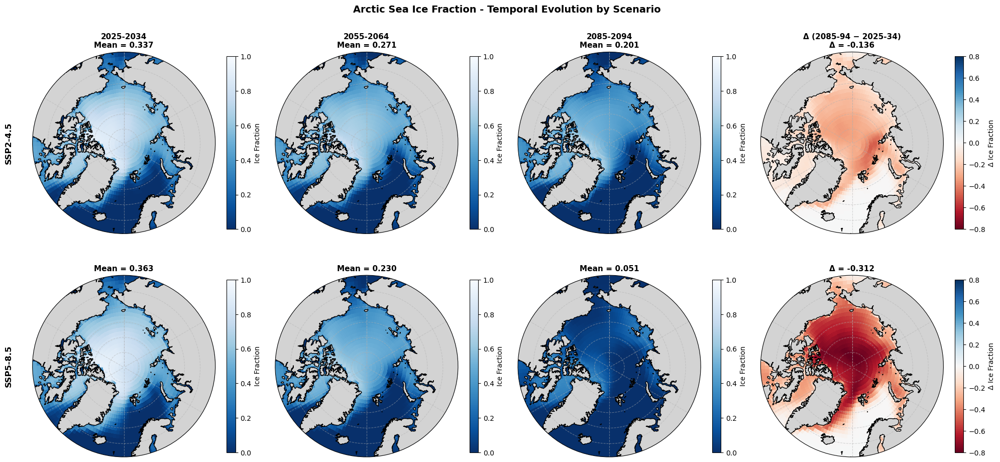

In [ ]:
# ============================================================
# ARCTIC SEA ICE FRACTION (2x4): Rows = scenarios, Cols = decades + temporal difference
# ============================================================

ice_var = 'sicf'

ssp245_ar_25_ice = ssp245_ar_25_34[ice_var].mean(dim='time')
ssp245_ar_55_ice = ssp245_ar_55_64[ice_var].mean(dim='time')
ssp245_ar_85_ice = ssp245_ar_85_94[ice_var].mean(dim='time')

ssp585_ar_25_ice = ssp585_ar_25_34[ice_var].mean(dim='time')
ssp585_ar_55_ice = ssp585_ar_55_64[ice_var].mean(dim='time')
ssp585_ar_85_ice = ssp585_ar_85_94[ice_var].mean(dim='time')

# Temporal differences
diff_ice_245_temporal = ssp245_ar_85_ice - ssp245_ar_25_ice
diff_ice_585_temporal = ssp585_ar_85_ice - ssp585_ar_25_ice

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ar_ice, axes_ar_ice = plt.subplots(2, 4, figsize=(20, 10),
                                        subplot_kw={'projection': ccrs.NorthPolarStereo()})

arctic_ice_data = [
    [ssp245_ar_25_ice, ssp245_ar_55_ice, ssp245_ar_85_ice, diff_ice_245_temporal],
    [ssp585_ar_25_ice, ssp585_ar_55_ice, ssp585_ar_85_ice, diff_ice_585_temporal],
]
row_labels = ['SSP2-4.5', 'SSP5-8.5']
col_labels = ['2025-2034', '2055-2064', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, row in enumerate(arctic_ice_data):
    for j, data in enumerate(row):
        ax = axes_ar_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        spatial_mean = float(data.mean())
        
        if j == 3:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.8, vmax=0.8)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, row_labels[i], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ar_ice.suptitle('Arctic Sea Ice Fraction - Temporal Evolution by Scenario', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_temporal_evolution.png', dpi=150, bbox_inches='tight')
plt.show()

### Seasonal analysis

In [15]:
# ============================================================
# SEASONAL ANALYSIS - Helper function to select seasons
# ============================================================

def select_season(ds, season):
    """Select data for a specific season.
    SON: September-November
    DJF: December-February
    MAM: March-May
    JJA: June-August
    """
    month = ds['time'].dt.month
    if season == 'SON':
        return ds.sel(time=(month >= 9) & (month <= 11))
    elif season == 'DJF':
        return ds.sel(time=(month == 12) | (month <= 2))
    elif season == 'MAM':
        return ds.sel(time=(month >= 3) & (month <= 5))
    elif season == 'JJA':
        return ds.sel(time=(month >= 6) & (month <= 8))
    else:
        raise ValueError(f"Unknown season: {season}")

seasons = ['SON', 'DJF', 'MAM', 'JJA']
season_names = {'SON': 'Sep-Nov', 'DJF': 'Dec-Feb', 'MAM': 'Mar-May', 'JJA': 'Jun-Aug'}

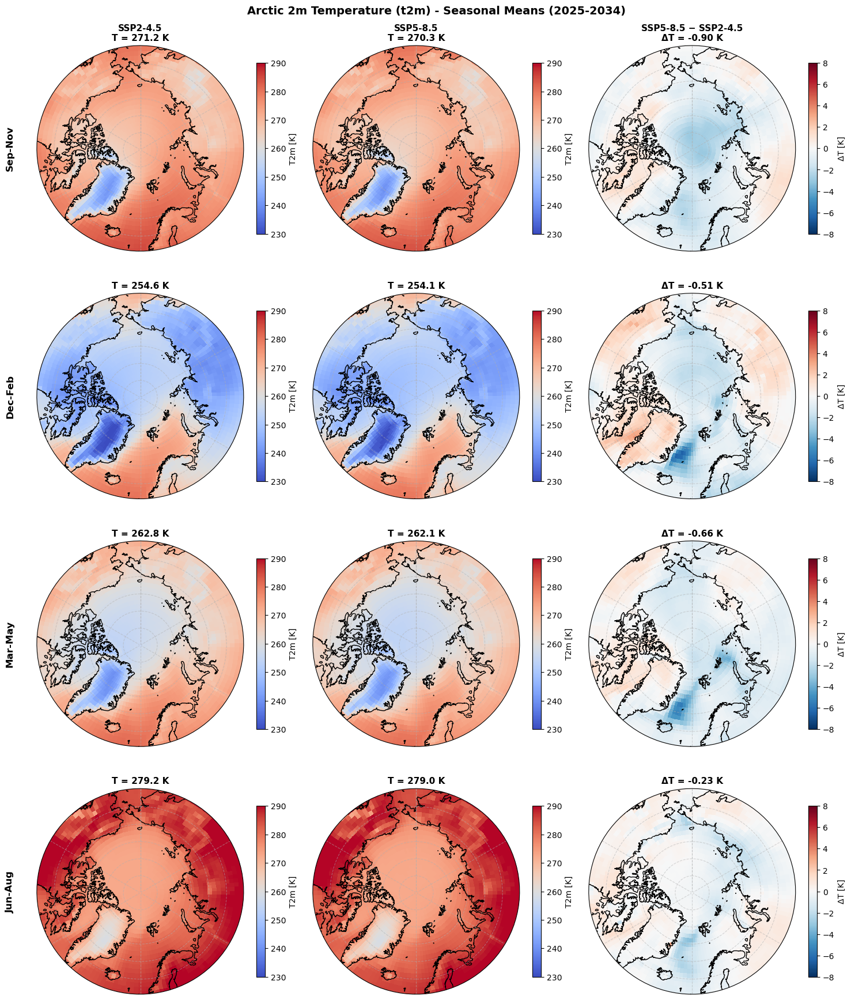

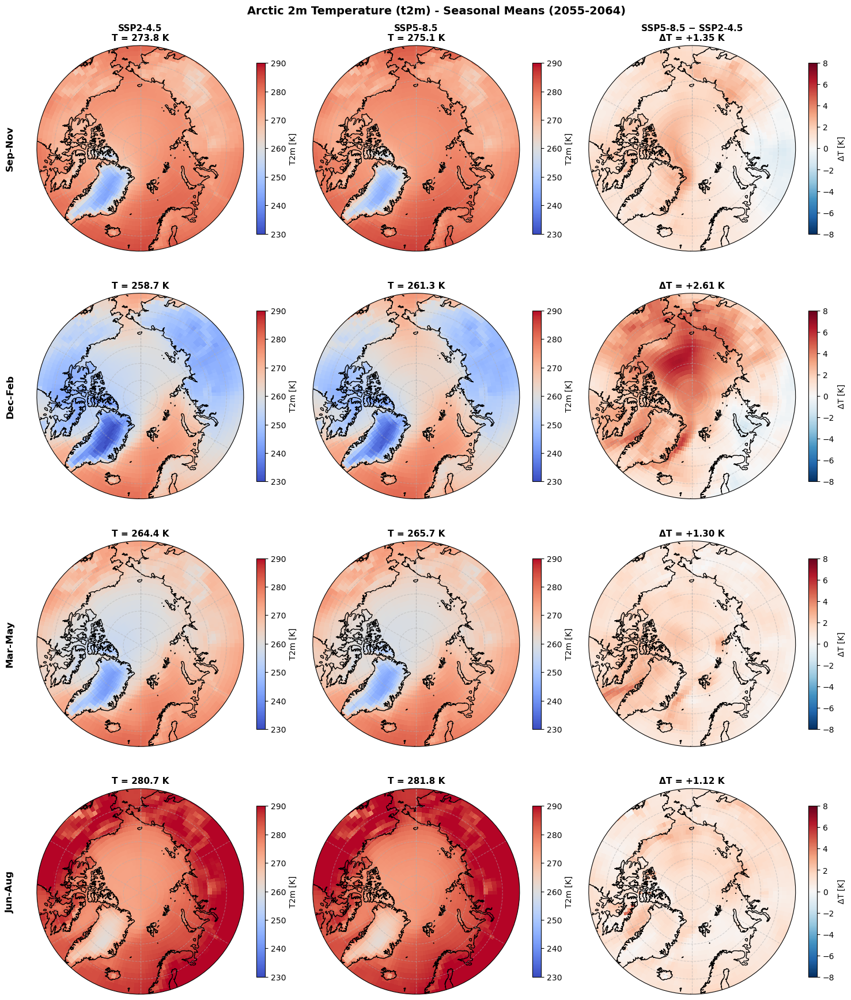

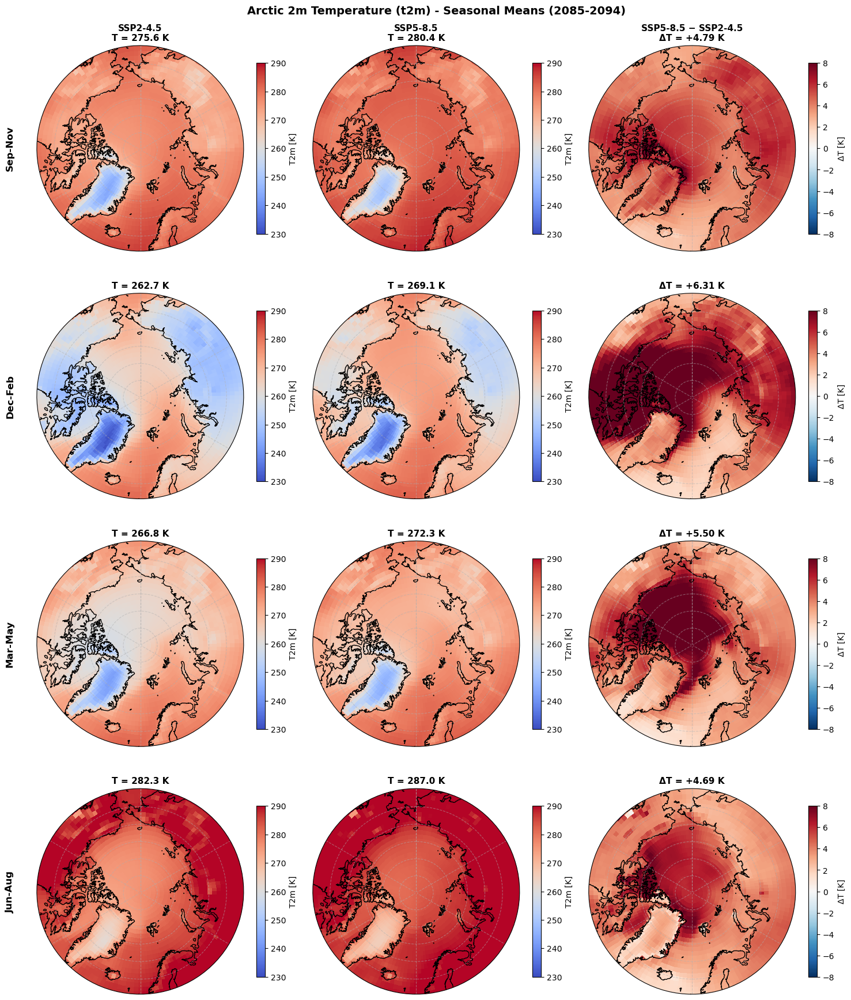

In [ ]:
# ============================================================
# ARCTIC T2M - SEASONAL ANALYSIS (3 separate plots for each decade)
# ============================================================

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

# Datasets for each decade
arctic_datasets = {
    '2025-2034': {'ssp245': ssp245_ar_25_34, 'ssp585': ssp585_ar_25_34},
    '2055-2064': {'ssp245': ssp245_ar_55_64, 'ssp585': ssp585_ar_55_64},
    '2085-2094': {'ssp245': ssp245_ar_85_94, 'ssp585': ssp585_ar_85_94},
}

for decade, datasets in arctic_datasets.items():
    fig_ar, axes_ar = plt.subplots(4, 3, figsize=(15, 18),
                                    subplot_kw={'projection': ccrs.NorthPolarStereo()})
    
    col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']
    
    for i, season in enumerate(seasons):
        # Compute seasonal means
        ssp245_season = select_season(datasets['ssp245']['t2m'], season).mean(dim='time')
        ssp585_season = select_season(datasets['ssp585']['t2m'], season).mean(dim='time')
        diff_season = ssp585_season - ssp245_season
        
        season_data = [ssp245_season, ssp585_season, diff_season]
        
        for j, data in enumerate(season_data):
            ax = axes_ar[i, j]
            ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
            
            # Compute spatial mean for title
            spatial_mean = float(data.mean())
            
            if j == 2:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='RdBu_r', vmin=-8, vmax=8)
                cbar_label = 'ΔT [K]'
                mean_text = f'ΔT = {spatial_mean:+.2f} K'
            else:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='coolwarm', vmin=230, vmax=290)
                cbar_label = 'T2m [K]'
                mean_text = f'T = {spatial_mean:.1f} K'
            
            ax.coastlines()
            ax.gridlines(linestyle='--', alpha=0.5)
            ax.set_boundary(map_circle, transform=ax.transAxes)
            
            plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
            
            # Column label only on first row, mean on all subplots
            if i == 0:
                ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
            else:
                ax.set_title(mean_text, fontsize=11, fontweight='bold')
            
            # Season label on left
            if j == 0:
                ax.text(-0.15, 0.5, season_names[season], transform=ax.transAxes,
                        fontsize=12, fontweight='bold', va='center', rotation=90)
    
    fig_ar.suptitle(f'Arctic 2m Temperature (t2m) - Seasonal Means ({decade})', fontsize=14, fontweight='bold')
    plt.tight_layout()
    #plt.savefig(f'figs_spacial/arctic_t2m_seasonal_{decade.replace("-", "_")}.png', dpi=150, bbox_inches='tight')
    plt.show()

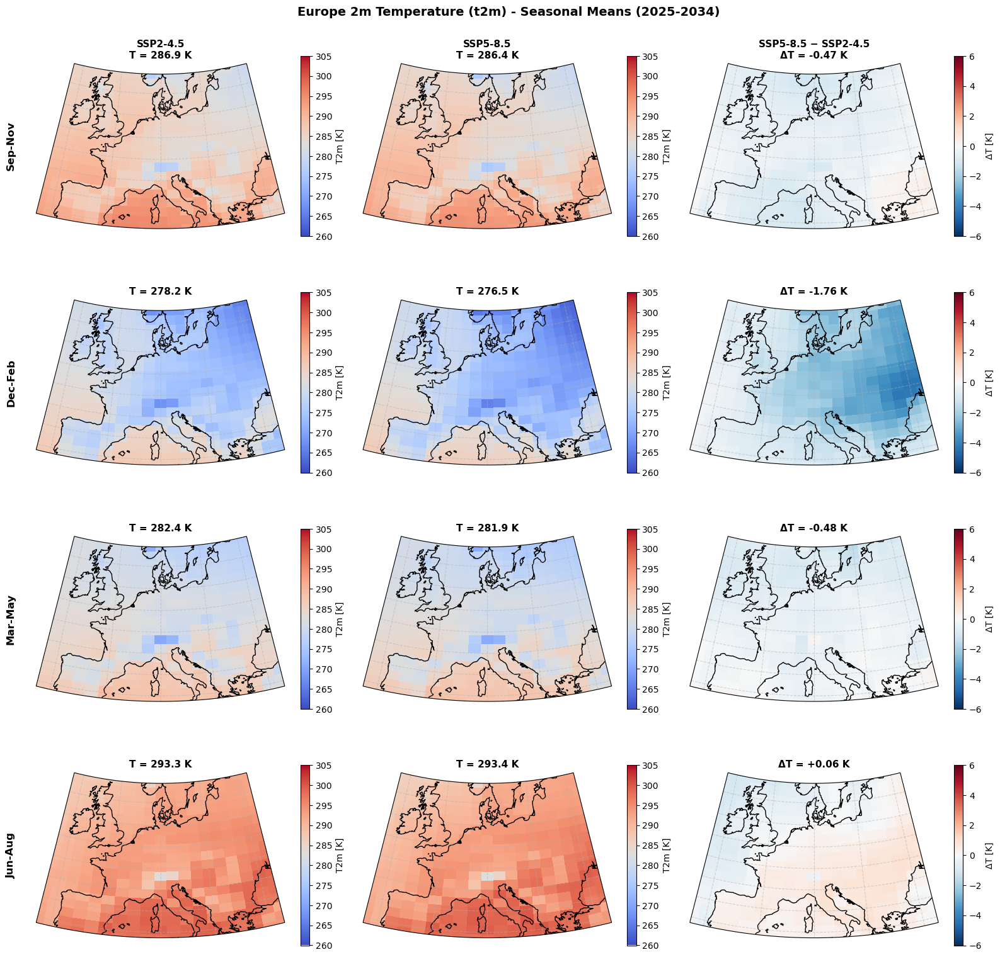

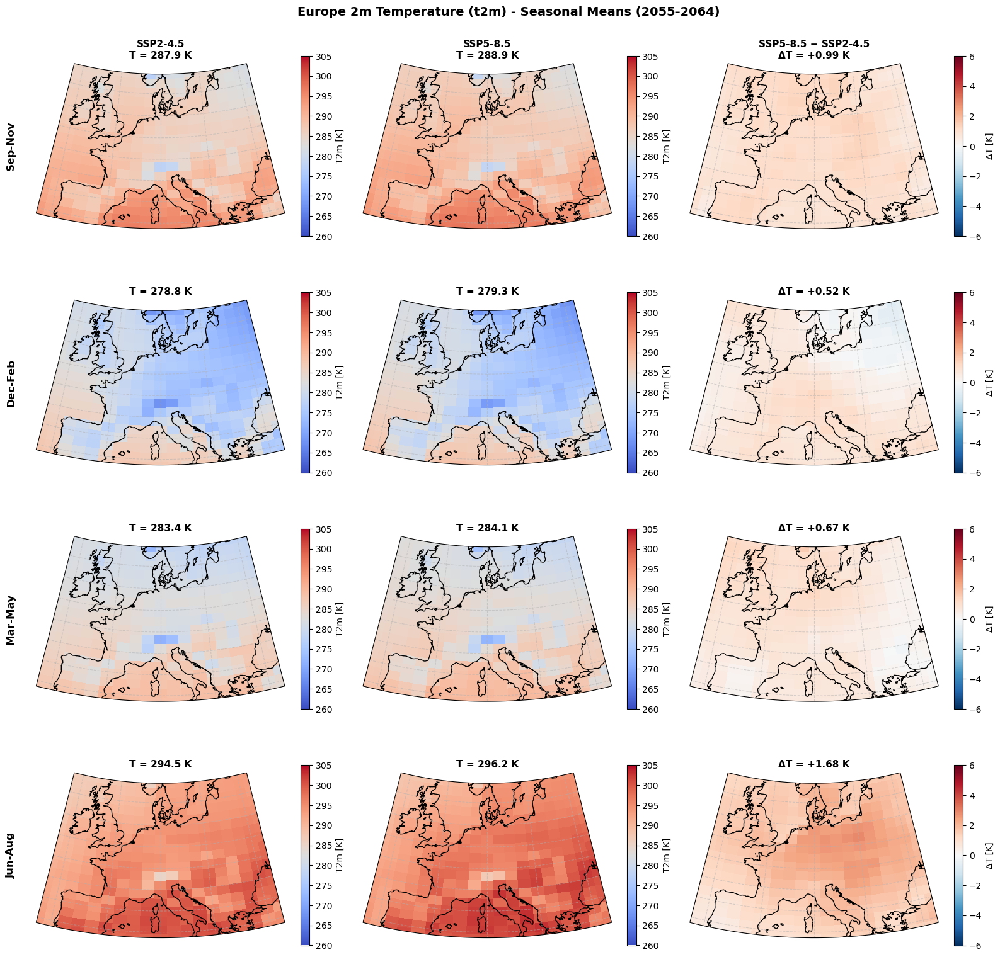

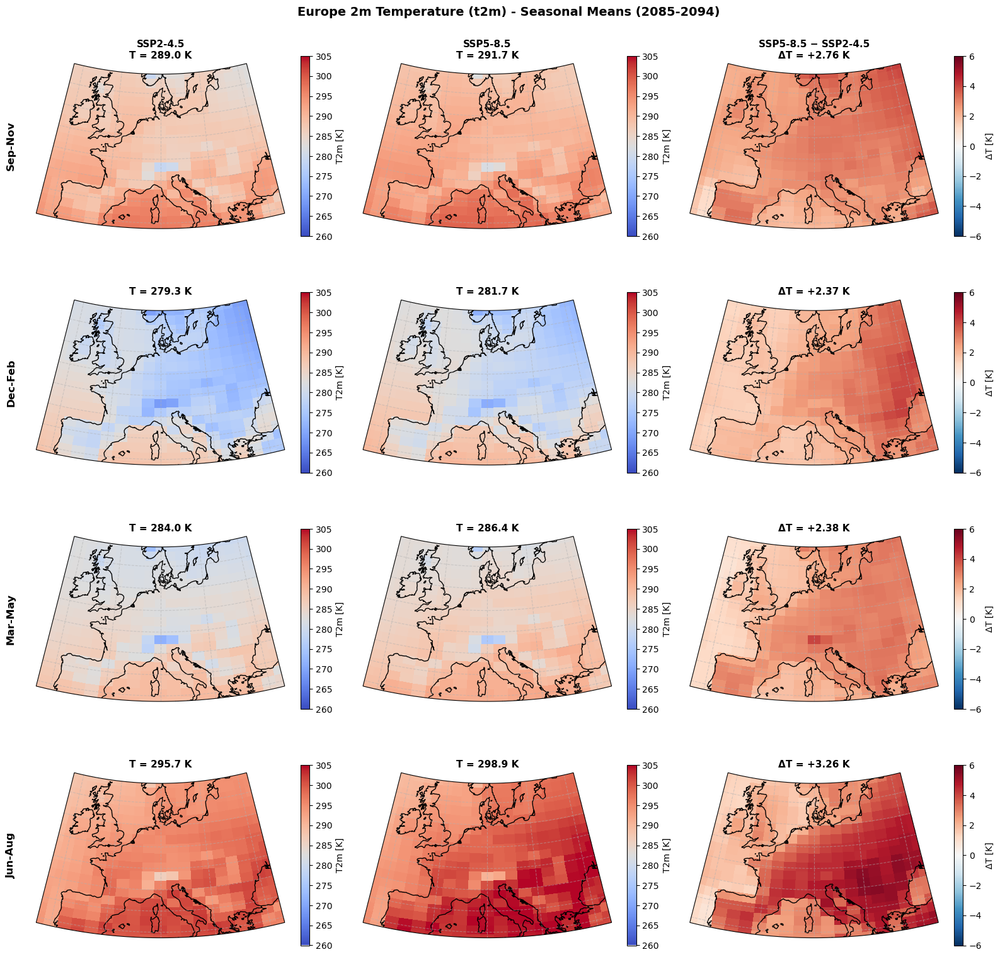

In [ ]:
# ============================================================
# EUROPE T2M - SEASONAL ANALYSIS (3 separate plots for each decade)
# ============================================================

# Get data bounds from first dataset
lon_min = float(ssp245_eu_25_34['t2m'].lon.min())
lon_max = float(ssp245_eu_25_34['t2m'].lon.max())
lat_min = float(ssp245_eu_25_34['t2m'].lat.min())
lat_max = float(ssp245_eu_25_34['t2m'].lat.max())

# Create boundary path
proj = ccrs.LambertConformal(central_longitude=(lon_min+lon_max)/2)
n_points = 50
bottom = np.column_stack([np.linspace(lon_min, lon_max, n_points), np.full(n_points, lat_min)])
right = np.column_stack([np.full(n_points, lon_max), np.linspace(lat_min, lat_max, n_points)])
top = np.column_stack([np.linspace(lon_max, lon_min, n_points), np.full(n_points, lat_max)])
left = np.column_stack([np.full(n_points, lon_min), np.linspace(lat_max, lat_min, n_points)])
boundary_lonlat = np.vstack([bottom, right, top, left])
boundary_proj = proj.transform_points(ccrs.PlateCarree(), boundary_lonlat[:, 0], boundary_lonlat[:, 1])
boundary_proj = boundary_proj[:, :2]
x_min, x_max = boundary_proj[:, 0].min(), boundary_proj[:, 0].max()
y_min, y_max = boundary_proj[:, 1].min(), boundary_proj[:, 1].max()
boundary_norm = np.column_stack([
    (boundary_proj[:, 0] - x_min) / (x_max - x_min),
    (boundary_proj[:, 1] - y_min) / (y_max - y_min)
])
data_boundary = mpath.Path(boundary_norm)

# Datasets for each decade
europe_datasets = {
    '2025-2034': {'ssp245': ssp245_eu_25_34, 'ssp585': ssp585_eu_25_34},
    '2055-2064': {'ssp245': ssp245_eu_55_64, 'ssp585': ssp585_eu_55_64},
    '2085-2094': {'ssp245': ssp245_eu_85_94, 'ssp585': ssp585_eu_85_94},
}

for decade, datasets in europe_datasets.items():
    fig_eu, axes_eu = plt.subplots(4, 3, figsize=(16, 16),
                                    subplot_kw={'projection': proj})
    
    col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']
    
    for i, season in enumerate(seasons):
        # Compute seasonal means
        ssp245_season = select_season(datasets['ssp245']['t2m'], season).mean(dim='time')
        ssp585_season = select_season(datasets['ssp585']['t2m'], season).mean(dim='time')
        diff_season = ssp585_season - ssp245_season
        
        season_data = [ssp245_season, ssp585_season, diff_season]
        
        for j, data in enumerate(season_data):
            ax = axes_eu[i, j]
            ax.set_extent([lon_min, lon_max, lat_min, lat_max], ccrs.PlateCarree())
            ax.set_boundary(data_boundary, transform=ax.transAxes)
            
            # Compute spatial mean for title
            spatial_mean = float(data.mean())
            
            if j == 2:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='RdBu_r', vmin=-6, vmax=6)
                cbar_label = 'ΔT [K]'
                mean_text = f'ΔT = {spatial_mean:+.2f} K'
            else:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='coolwarm', vmin=260, vmax=305)
                cbar_label = 'T2m [K]'
                mean_text = f'T = {spatial_mean:.1f} K'
            
            ax.coastlines()
            ax.gridlines(draw_labels=False, linestyle='--', alpha=0.5)
            
            plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
            
            # Column label only on first row, mean on all subplots
            if i == 0:
                ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
            else:
                ax.set_title(mean_text, fontsize=11, fontweight='bold')
            
            # Season label on left
            if j == 0:
                ax.text(-0.12, 0.5, season_names[season], transform=ax.transAxes,
                        fontsize=12, fontweight='bold', va='center', rotation=90)
    
    fig_eu.suptitle(f'Europe 2m Temperature (t2m) - Seasonal Means ({decade})', fontsize=14, fontweight='bold')
    plt.tight_layout()
    #plt.savefig(f'figs_spacial/europe_t2m_seasonal_{decade.replace("-", "_")}.png', dpi=150, bbox_inches='tight')
    plt.show()

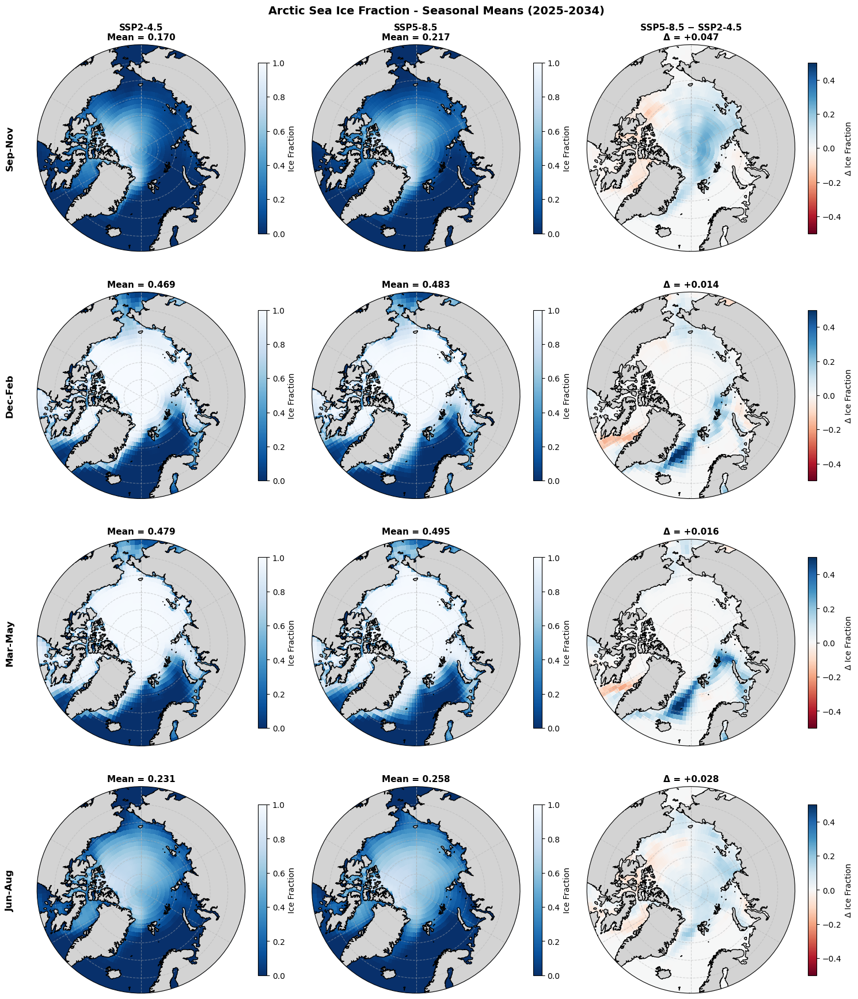

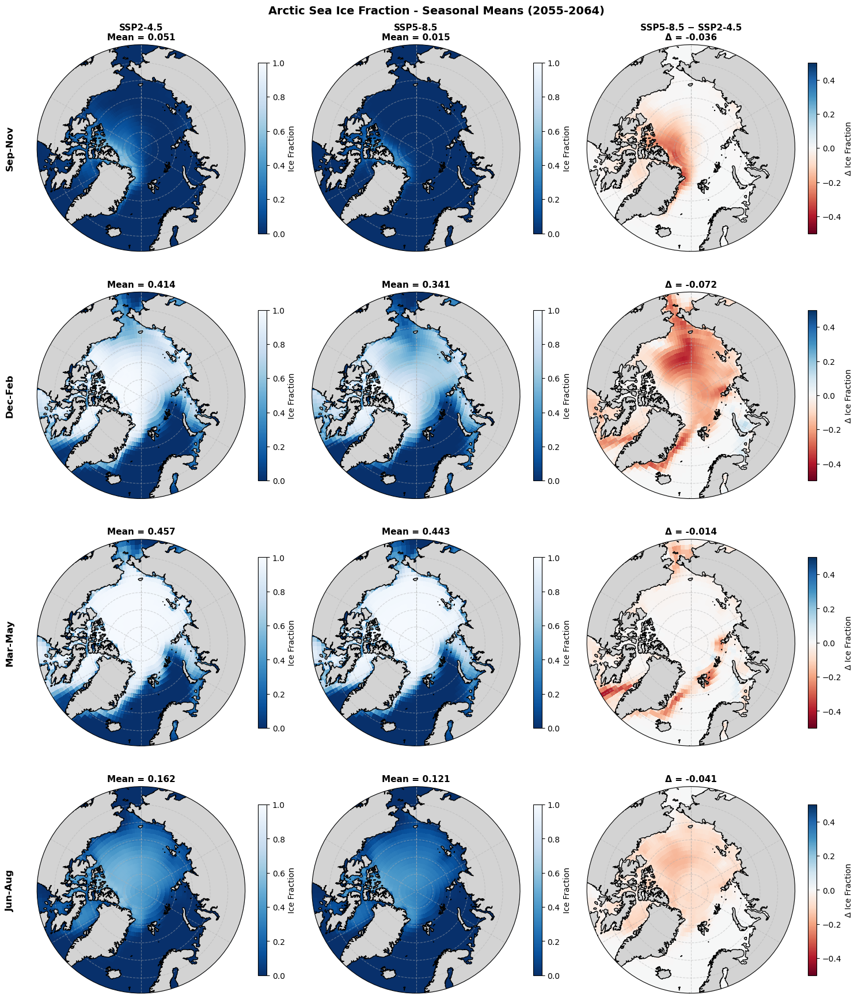

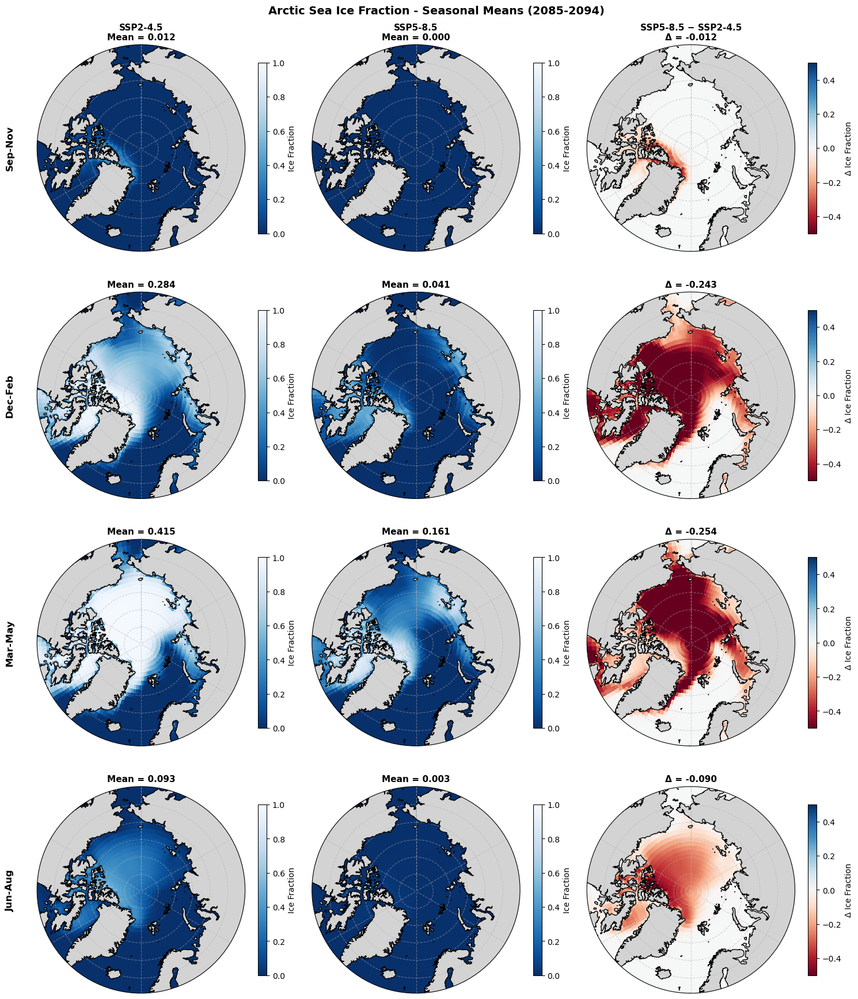

In [ ]:
# ============================================================
# ARCTIC SEA ICE FRACTION - SEASONAL ANALYSIS (3 separate plots for each decade)
# ============================================================

ice_var = 'sicf'

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

# Datasets for each decade
arctic_datasets = {
    '2025-2034': {'ssp245': ssp245_ar_25_34, 'ssp585': ssp585_ar_25_34},
    '2055-2064': {'ssp245': ssp245_ar_55_64, 'ssp585': ssp585_ar_55_64},
    '2085-2094': {'ssp245': ssp245_ar_85_94, 'ssp585': ssp585_ar_85_94},
}

for decade, datasets in arctic_datasets.items():
    fig_ice, axes_ice = plt.subplots(4, 3, figsize=(15, 18),
                                      subplot_kw={'projection': ccrs.NorthPolarStereo()})
    
    col_labels = ['SSP2-4.5', 'SSP5-8.5', 'SSP5-8.5 − SSP2-4.5']
    
    for i, season in enumerate(seasons):
        # Compute seasonal means
        ssp245_season = select_season(datasets['ssp245'][ice_var], season).mean(dim='time')
        ssp585_season = select_season(datasets['ssp585'][ice_var], season).mean(dim='time')
        diff_season = ssp585_season - ssp245_season
        
        season_data = [ssp245_season, ssp585_season, diff_season]
        
        for j, data in enumerate(season_data):
            ax = axes_ice[i, j]
            ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
            
            # Compute spatial mean for title
            spatial_mean = float(data.mean())
            
            if j == 2:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='RdBu', vmin=-0.5, vmax=0.5)
                cbar_label = 'Δ Ice Fraction'
                mean_text = f'Δ = {spatial_mean:+.3f}'
            else:
                c = ax.pcolormesh(data.lon, data.lat, data, 
                                  transform=ccrs.PlateCarree(), 
                                  cmap='Blues_r', vmin=0, vmax=1)
                cbar_label = 'Ice Fraction'
                mean_text = f'Mean = {spatial_mean:.3f}'
            
            ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
            ax.coastlines(zorder=3)
            ax.gridlines(linestyle='--', alpha=0.5)
            ax.set_boundary(map_circle, transform=ax.transAxes)
            
            plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
            
            # Column label only on first row, mean on all subplots
            if i == 0:
                ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
            else:
                ax.set_title(mean_text, fontsize=11, fontweight='bold')
            
            # Season label on left
            if j == 0:
                ax.text(-0.15, 0.5, season_names[season], transform=ax.transAxes,
                        fontsize=12, fontweight='bold', va='center', rotation=90)
    
    fig_ice.suptitle(f'Arctic Sea Ice Fraction - Seasonal Means ({decade})', fontsize=14, fontweight='bold')
    plt.tight_layout()
    #plt.savefig(f'figs_spacial/arctic_seaice_seasonal_{decade.replace("-", "_")}.png', dpi=150, bbox_inches='tight')
    plt.show()

### plots réduits

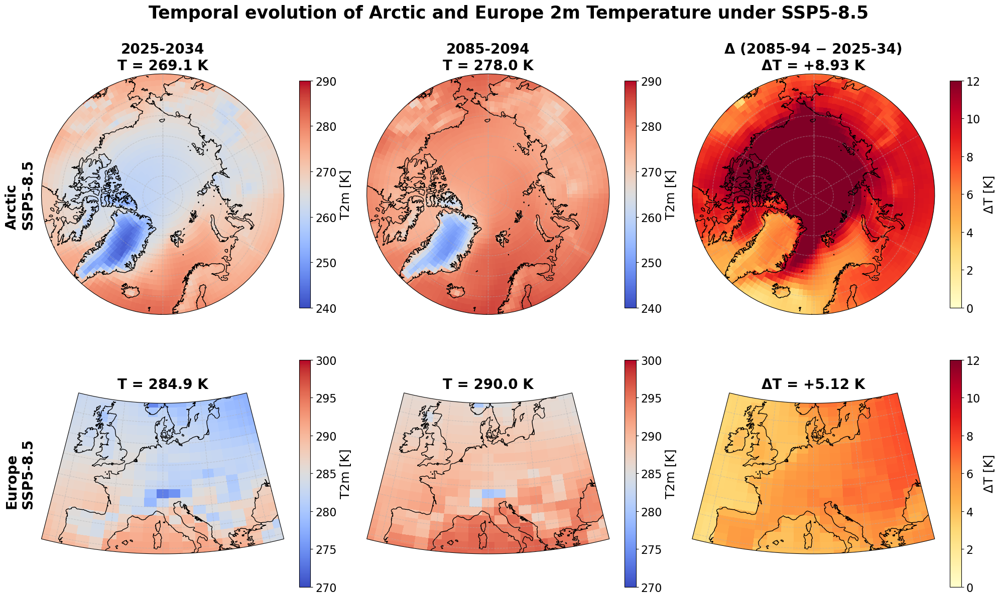

In [52]:
# ============================================================
# ARCTIC + EUROPE T2M (2x3): Rows = regions, Cols = decades + temporal difference
# ============================================================

# Compute decadal means for t2m - ARCTIC
ssp585_ar_25_mean = ssp585_ar_25_34['t2m'].mean(dim='time')
ssp585_ar_85_mean = ssp585_ar_85_94['t2m'].mean(dim='time')
diff_ar_585_temporal = ssp585_ar_85_mean - ssp585_ar_25_mean

# Compute decadal means for t2m - EUROPE
ssp585_eu_25_mean = ssp585_eu_25_34['t2m'].mean(dim='time')
ssp585_eu_85_mean = ssp585_eu_85_94['t2m'].mean(dim='time')
diff_eu_585_temporal = ssp585_eu_85_mean - ssp585_eu_25_mean

# Circular boundary path for Arctic
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

# Boundary path for Europe
lon_min = float(ssp585_eu_25_mean.lon.min())
lon_max = float(ssp585_eu_25_mean.lon.max())
lat_min = float(ssp585_eu_25_mean.lat.min())
lat_max = float(ssp585_eu_25_mean.lat.max())

proj_eu = ccrs.LambertConformal(central_longitude=(lon_min+lon_max)/2)
n_points = 50
bottom = np.column_stack([np.linspace(lon_min, lon_max, n_points), np.full(n_points, lat_min)])
right = np.column_stack([np.full(n_points, lon_max), np.linspace(lat_min, lat_max, n_points)])
top = np.column_stack([np.linspace(lon_max, lon_min, n_points), np.full(n_points, lat_max)])
left = np.column_stack([np.full(n_points, lon_min), np.linspace(lat_max, lat_min, n_points)])
boundary_lonlat = np.vstack([bottom, right, top, left])
boundary_proj = proj_eu.transform_points(ccrs.PlateCarree(), boundary_lonlat[:, 0], boundary_lonlat[:, 1])
boundary_proj = boundary_proj[:, :2]
x_min, x_max = boundary_proj[:, 0].min(), boundary_proj[:, 0].max()
y_min, y_max = boundary_proj[:, 1].min(), boundary_proj[:, 1].max()
boundary_norm = np.column_stack([
    (boundary_proj[:, 0] - x_min) / (x_max - x_min),
    (boundary_proj[:, 1] - y_min) / (y_max - y_min)
])
data_boundary = mpath.Path(boundary_norm)

# Create figure with mixed projections
fig = plt.figure(figsize=(20, 13))

# Arctic row (North Polar Stereographic)
ax_ar_1 = fig.add_subplot(2, 3, 1, projection=ccrs.NorthPolarStereo())
ax_ar_2 = fig.add_subplot(2, 3, 2, projection=ccrs.NorthPolarStereo())
ax_ar_3 = fig.add_subplot(2, 3, 3, projection=ccrs.NorthPolarStereo())

# Europe row (Lambert Conformal)
ax_eu_1 = fig.add_subplot(2, 3, 4, projection=proj_eu)
ax_eu_2 = fig.add_subplot(2, 3, 5, projection=proj_eu)
ax_eu_3 = fig.add_subplot(2, 3, 6, projection=proj_eu)

axes_ar = [ax_ar_1, ax_ar_2, ax_ar_3]
axes_eu = [ax_eu_1, ax_eu_2, ax_eu_3]

# Data layout
regions_data = [
    {'name': 'Arctic', 'axes': axes_ar, 'data': [ssp585_ar_25_mean, ssp585_ar_85_mean, diff_ar_585_temporal],
     'extent': [-180, 180, 60, 90], 'boundary': map_circle, 't_range': [240, 290]},
    {'name': 'Europe', 'axes': axes_eu, 'data': [ssp585_eu_25_mean, ssp585_eu_85_mean, diff_eu_585_temporal],
     'extent': [lon_min, lon_max, lat_min, lat_max], 'boundary': data_boundary, 't_range': [270, 300]}
]

col_labels = ['2025-2034', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, region in enumerate(regions_data):
    for j, data in enumerate(region['data']):
        ax = region['axes'][j]
        ax.set_extent(region['extent'], ccrs.PlateCarree())
        
        weights = np.cos(np.deg2rad(data.lat))
        spatial_mean = data.weighted(weights).mean(("lat","lon")).item()

        #spatial_mean = float(data.mean())
        
        if j == 2:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='YlOrRd', vmin=0, vmax=12)  # Adjusted colormap and range
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=region['t_range'][0], vmax=region['t_range'][1])
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(linestyle='--', alpha=0.5, draw_labels=False)
        ax.set_boundary(region['boundary'], transform=ax.transAxes)
        
        cbar = plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        cbar.set_label(cbar_label, fontsize=18)  # Label font size
        cbar.ax.tick_params(labelsize=16)  # Tick labels font size
        
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=20, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=20, fontweight='bold')
        
        if j == 0:
            ax.text(-0.15, 0.5, f'{region["name"]}\nSSP5-8.5', transform=ax.transAxes,
                    fontsize=20, fontweight='bold', va='center', rotation=90)

fig.suptitle('Temporal evolution of Arctic and Europe 2m Temperature under SSP5-8.5', fontsize=25, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_europe_t2m_ssp585.png', dpi=150, bbox_inches='tight')
plt.show()

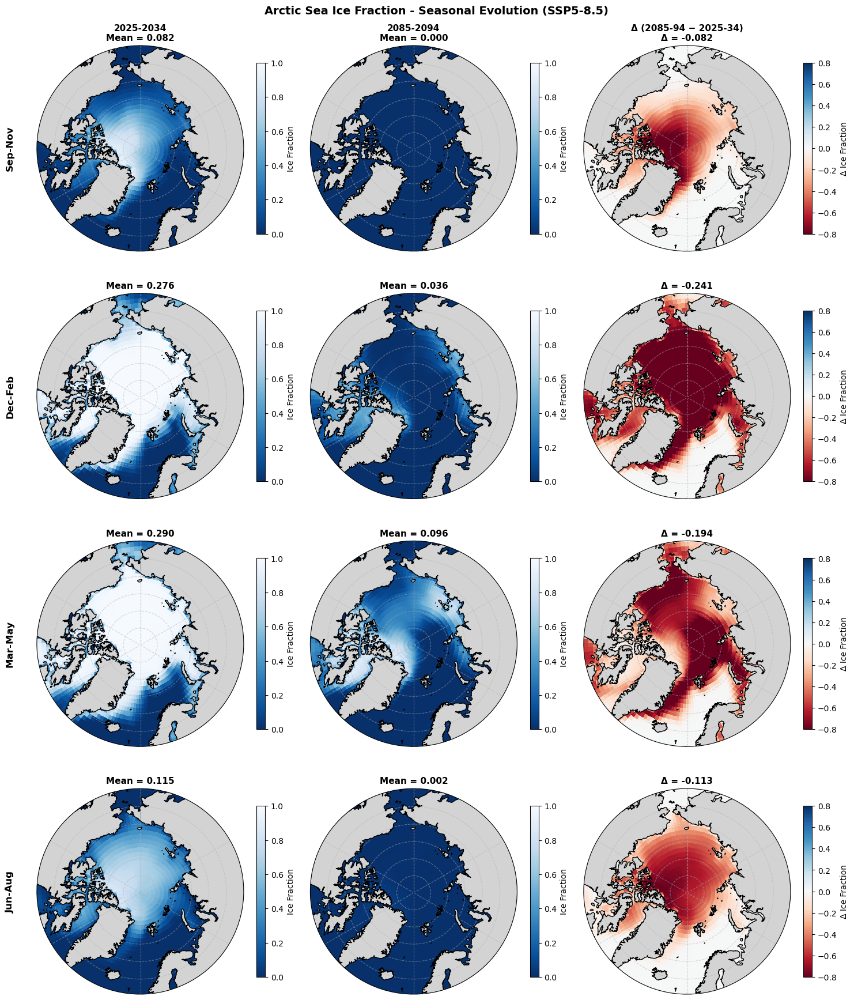

In [24]:
# ============================================================
# ARCTIC SEA ICE FRACTION - SEASONAL ANALYSIS (SSP5-8.5 ONLY)
# Columns: 2025-2034, 2085-2094, Δ (2085-94 − 2025-34)
# ============================================================

ice_var = 'sicf'

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ice, axes_ice = plt.subplots(4, 3, figsize=(15, 18),
                                  subplot_kw={'projection': ccrs.NorthPolarStereo()})

col_labels = ['2025-2034', '2085-2094', 'Δ (2085-94 − 2025-34)']

for i, season in enumerate(seasons):
    # Compute seasonal means for both decades
    ssp585_25_season = select_season(ssp585_ar_25_34[ice_var], season).mean(dim='time')
    ssp585_85_season = select_season(ssp585_ar_85_94[ice_var], season).mean(dim='time')
    
    # Temporal difference (2085-2094 minus 2025-2034)
    diff_temporal = ssp585_85_season - ssp585_25_season
    
    season_data = [ssp585_25_season, ssp585_85_season, diff_temporal]
    
    for j, data in enumerate(season_data):
        ax = axes_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        weights = np.cos(np.deg2rad(data.lat))
        spatial_mean = data.weighted(weights).mean(("lat","lon")).item()

        #spatial_mean = float(data.mean())
        
        if j == 2:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.8, vmax=0.8)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.7, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        # Season label on left
        if j == 0:
            ax.text(-0.15, 0.5, season_names[season], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ice.suptitle('Arctic Sea Ice Fraction - Seasonal Evolution (SSP5-8.5)', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_seasonal_ssp585_temporal.png', dpi=150, bbox_inches='tight')
plt.show()

### pour les mois plus chaud/froid

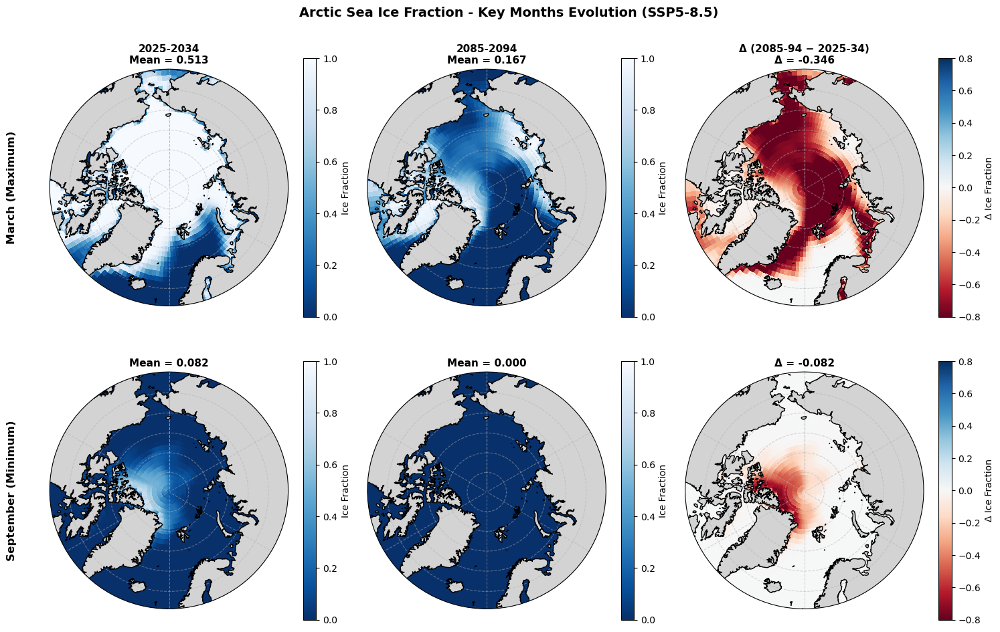

In [25]:
# ============================================================
# ARCTIC SEA ICE FRACTION - KEY MONTHS ANALYSIS (SSP5-8.5 ONLY)
# Rows: March (max ice) and September (min ice)
# Columns: 2025-2034, 2085-2094, Δ (2085-94 − 2025-34)
# ============================================================

ice_var = 'sicf'

# Helper function to select specific month
def select_month(ds, month):
    """Select data for a specific month."""
    return ds.sel(time=ds['time'].dt.month == month)

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ice, axes_ice = plt.subplots(2, 3, figsize=(15, 10),
                                  subplot_kw={'projection': ccrs.NorthPolarStereo()})

col_labels = ['2025-2034', '2085-2094', 'Δ (2085-94 − 2025-34)']
ice_months = [3, 9]  # March (maximum) and September (minimum)
ice_month_names = {3: 'March (Maximum)', 9: 'September (Minimum)'}

for i, month in enumerate(ice_months):
    # Compute monthly means for both decades
    ssp585_25_month = select_month(ssp585_ar_25_34[ice_var], month).mean(dim='time')
    ssp585_85_month = select_month(ssp585_ar_85_94[ice_var], month).mean(dim='time')
    
    # Temporal difference (2085-2094 minus 2025-2034)
    diff_temporal = ssp585_85_month - ssp585_25_month
    
    month_data = [ssp585_25_month, ssp585_85_month, diff_temporal]
    
    for j, data in enumerate(month_data):
        ax = axes_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        weights = np.cos(np.deg2rad(data.lat))
        spatial_mean = data.weighted(weights).mean(("lat","lon")).item()

        spatial_mean = float(data.mean())
        
        if j == 2:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.8, vmax=0.8)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.8, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        # Month label on left
        if j == 0:
            ax.text(-0.18, 0.5, ice_month_names[month], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_ice.suptitle('Arctic Sea Ice Fraction - Key Months Evolution (SSP5-8.5)', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_key_months_ssp585_temporal.png', dpi=150, bbox_inches='tight')
plt.show()

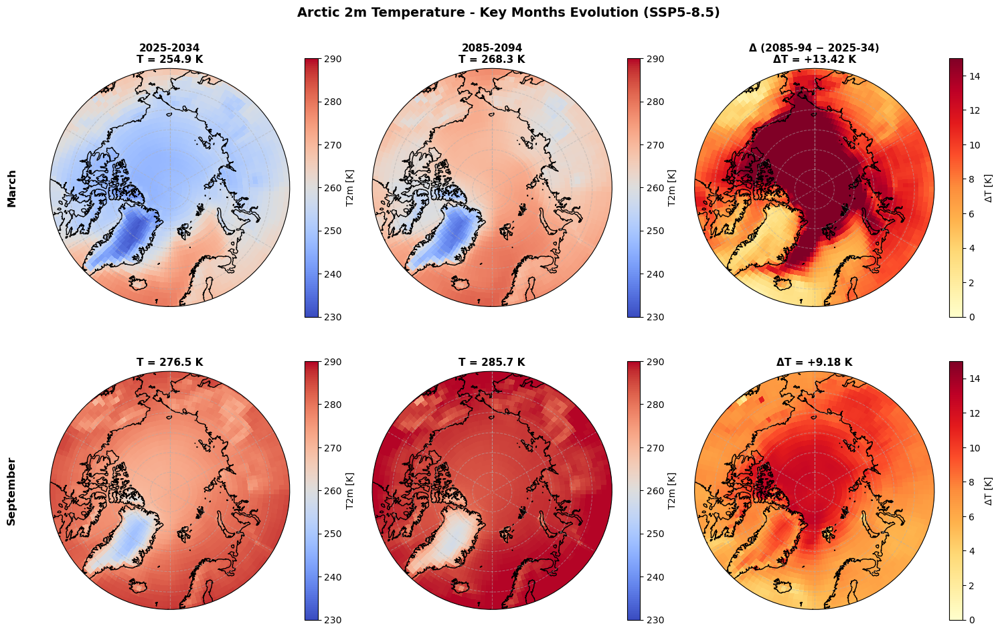

In [18]:
# ============================================================
# ARCTIC T2M - KEY MONTHS ANALYSIS (SSP5-8.5 ONLY)
# Rows: March (winter) and September (end of summer)
# Columns: 2025-2034, 2085-2094, Δ (2085-94 − 2025-34)
# ============================================================

# Helper function to select specific month
def select_month(ds, month):
    """Select data for a specific month."""
    return ds.sel(time=ds['time'].dt.month == month)

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_t2m, axes_t2m = plt.subplots(2, 3, figsize=(15, 10),
                                  subplot_kw={'projection': ccrs.NorthPolarStereo()})

col_labels = ['2025-2034', '2085-2094', 'Δ (2085-94 − 2025-34)']
key_months = [3, 9]  # March and September
key_month_names = {3: 'March', 9: 'September'}

for i, month in enumerate(key_months):
    # Compute monthly means for both decades
    ssp585_25_month = select_month(ssp585_ar_25_34['t2m'], month).mean(dim='time')
    ssp585_85_month = select_month(ssp585_ar_85_94['t2m'], month).mean(dim='time')
    
    # Temporal difference (2085-2094 minus 2025-2034)
    diff_temporal = ssp585_85_month - ssp585_25_month
    
    month_data = [ssp585_25_month, ssp585_85_month, diff_temporal]
    
    for j, data in enumerate(month_data):
        ax = axes_t2m[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        spatial_mean = float(data.mean())
        
        if j == 2:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='YlOrRd', vmin=0, vmax=15)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=230, vmax=290)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.8, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=11, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=11, fontweight='bold')
        
        # Month label on left
        if j == 0:
            ax.text(-0.18, 0.5, key_month_names[month], transform=ax.transAxes,
                    fontsize=12, fontweight='bold', va='center', rotation=90)

fig_t2m.suptitle('Arctic 2m Temperature - Key Months Evolution (SSP5-8.5)', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_t2m_key_months_ssp585_temporal.png', dpi=150, bbox_inches='tight')
plt.show()

### pour tous les mois 

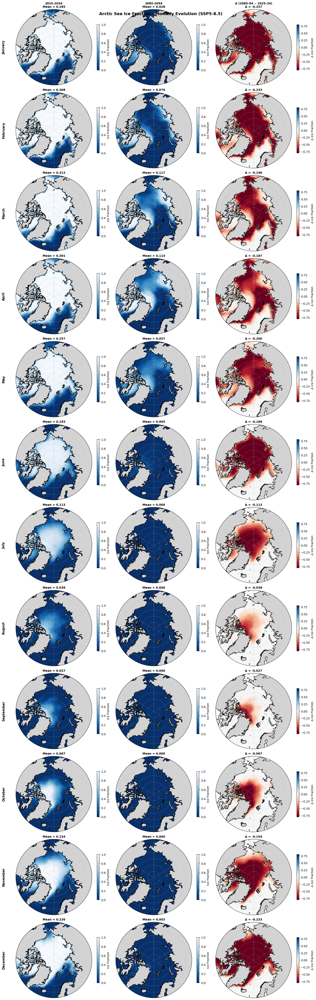

In [26]:
# ============================================================
# ARCTIC SEA ICE FRACTION - ALL MONTHS ANALYSIS (SSP5-8.5 ONLY)
# Rows: All 12 months
# Columns: 2025-2034, 2085-2094, Δ (2085-94 − 2025-34)
# ============================================================

ice_var = 'sicf'

# Helper function to select specific month
def select_month(ds, month):
    """Select data for a specific month."""
    return ds.sel(time=ds['time'].dt.month == month)

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ice, axes_ice = plt.subplots(12, 3, figsize=(15, 48),
                                  subplot_kw={'projection': ccrs.NorthPolarStereo()})

col_labels = ['2025-2034', '2085-2094', 'Δ (2085-94 − 2025-34)']
month_names = ['January', 'February', 'March', 'April', 'May', 'June',
               'July', 'August', 'September', 'October', 'November', 'December']

for i, month in enumerate(range(1, 13)):  # Months 1-12
    # Compute monthly means for both decades
    ssp585_25_month = select_month(ssp585_ar_25_34[ice_var], month).mean(dim='time')
    ssp585_85_month = select_month(ssp585_ar_85_94[ice_var], month).mean(dim='time')
    
    # Temporal difference (2085-2094 minus 2025-2034)
    diff_temporal = ssp585_85_month - ssp585_25_month
    
    month_data = [ssp585_25_month, ssp585_85_month, diff_temporal]
    
    for j, data in enumerate(month_data):
        ax = axes_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        weights = np.cos(np.deg2rad(data.lat))
        spatial_mean = data.weighted(weights).mean(("lat","lon")).item()

        
        if j == 2:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.8, vmax=0.8)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.6, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=10, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=10, fontweight='bold')
        
        # Month label on left
        if j == 0:
            ax.text(-0.18, 0.5, month_names[i], transform=ax.transAxes,
                    fontsize=11, fontweight='bold', va='center', rotation=90)

fig_ice.suptitle('Arctic Sea Ice Fraction - Monthly Evolution (SSP5-8.5)', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_all_months_ssp585_temporal.png', dpi=150, bbox_inches='tight')
plt.show()

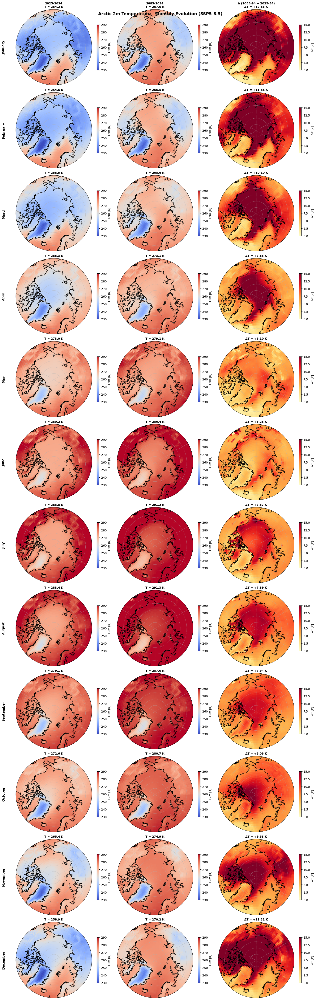

In [27]:
# ============================================================
# ARCTIC T2M - ALL MONTHS ANALYSIS (SSP5-8.5 ONLY)
# Rows: All 12 months
# Columns: 2025-2034, 2085-2094, Δ (2085-94 − 2025-34)
# ============================================================

# Helper function to select specific month
def select_month(ds, month):
    """Select data for a specific month."""
    return ds.sel(time=ds['time'].dt.month == month)

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_t2m, axes_t2m = plt.subplots(12, 3, figsize=(15, 48),
                                  subplot_kw={'projection': ccrs.NorthPolarStereo()})

col_labels = ['2025-2034', '2085-2094', 'Δ (2085-94 − 2025-34)']
month_names = ['January', 'February', 'March', 'April', 'May', 'June',
               'July', 'August', 'September', 'October', 'November', 'December']

for i, month in enumerate(range(1, 13)):  # Months 1-12
    # Compute monthly means for both decades
    ssp585_25_month = select_month(ssp585_ar_25_34['t2m'], month).mean(dim='time')
    ssp585_85_month = select_month(ssp585_ar_85_94['t2m'], month).mean(dim='time')
    
    # Temporal difference (2085-2094 minus 2025-2034)
    diff_temporal = ssp585_85_month - ssp585_25_month
    
    month_data = [ssp585_25_month, ssp585_85_month, diff_temporal]
    
    for j, data in enumerate(month_data):
        ax = axes_t2m[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        weights = np.cos(np.deg2rad(data.lat))
        spatial_mean = data.weighted(weights).mean(("lat","lon")).item()

        
        if j == 2:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='YlOrRd', vmin=0, vmax=15)
            cbar_label = 'ΔT [K]'
            mean_text = f'ΔT = {spatial_mean:+.2f} K'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='coolwarm', vmin=230, vmax=290)
            cbar_label = 'T2m [K]'
            mean_text = f'T = {spatial_mean:.1f} K'
        
        ax.coastlines()
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        plt.colorbar(c, ax=ax, shrink=0.6, pad=0.05, label=cbar_label)
        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=10, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=10, fontweight='bold')
        
        # Month label on left
        if j == 0:
            ax.text(-0.18, 0.5, month_names[i], transform=ax.transAxes,
                    fontsize=11, fontweight='bold', va='center', rotation=90)

fig_t2m.suptitle('Arctic 2m Temperature - Monthly Evolution (SSP5-8.5)', fontsize=14, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_t2m_all_months_ssp585_temporal.png', dpi=150, bbox_inches='tight')
plt.show()

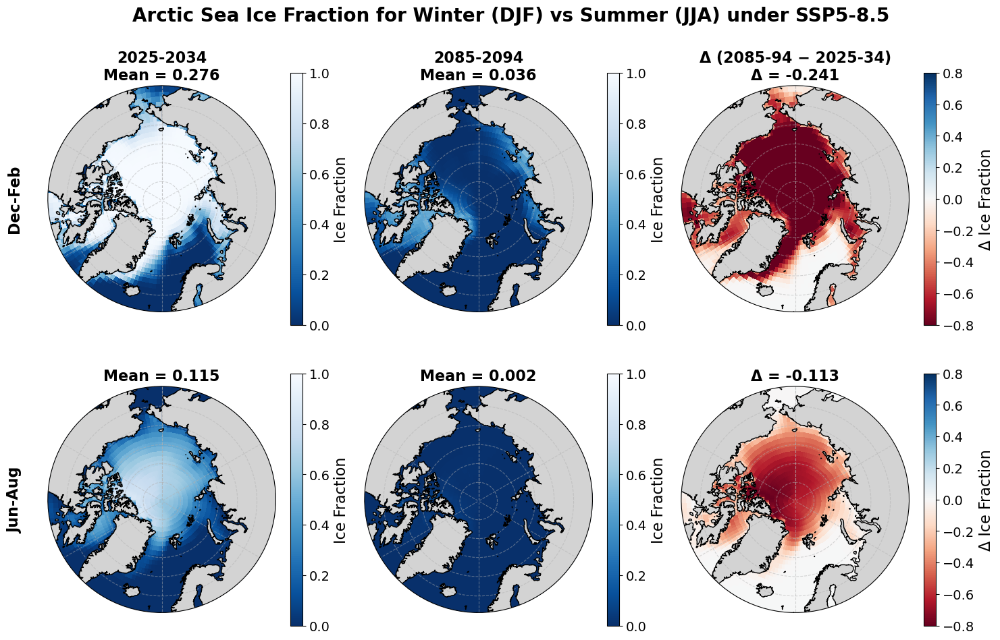

In [59]:
# ============================================================
# ARCTIC SEA ICE FRACTION - DJF vs JJA COMPARISON (SSP5-8.5 ONLY)
# Rows: DJF (winter) and JJA (summer)
# Columns: 2025-2034, 2085-2094, Δ (2085-94 − 2025-34)
# ============================================================

ice_var = 'sicf'

# Circular boundary path
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

fig_ice, axes_ice = plt.subplots(2, 3, figsize=(15, 10),
                                  subplot_kw={'projection': ccrs.NorthPolarStereo()})

col_labels = ['2025-2034', '2085-2094', 'Δ (2085-94 − 2025-34)']
key_seasons = ['DJF', 'JJA']  # Winter and Summer

for i, season in enumerate(key_seasons):
    # Compute seasonal means for both decades
    ssp585_25_season = select_season(ssp585_ar_25_34[ice_var], season).mean(dim='time')
    ssp585_85_season = select_season(ssp585_ar_85_94[ice_var], season).mean(dim='time')
    
    # Temporal difference (2085-2094 minus 2025-2034)
    diff_temporal = ssp585_85_season - ssp585_25_season
    
    season_data = [ssp585_25_season, ssp585_85_season, diff_temporal]
    
    for j, data in enumerate(season_data):
        ax = axes_ice[i, j]
        ax.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
        
        # Compute spatial mean for title
        weights = np.cos(np.deg2rad(data.lat))
        spatial_mean = data.weighted(weights).mean(("lat","lon")).item()
        
        if j == 2:  # Temporal difference column
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='RdBu', vmin=-0.8, vmax=0.8)
            cbar_label = 'Δ Ice Fraction'
            mean_text = f'Δ = {spatial_mean:+.3f}'
        else:
            c = ax.pcolormesh(data.lon, data.lat, data, 
                              transform=ccrs.PlateCarree(), 
                              cmap='Blues_r', vmin=0, vmax=1)
            cbar_label = 'Ice Fraction'
            mean_text = f'Mean = {spatial_mean:.3f}'
        
        ax.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
        ax.coastlines(zorder=3)
        ax.gridlines(linestyle='--', alpha=0.5)
        ax.set_boundary(map_circle, transform=ax.transAxes)
        
        cbar1 = plt.colorbar(c, ax=ax, shrink=0.8, pad=0.05, label=cbar_label)
        cbar1.set_label(cbar_label, fontsize=16)  # Label font size
        cbar1.ax.tick_params(labelsize=14)  # Tick labels font size 

        
        # Column label only on first row, mean on all subplots
        if i == 0:
            ax.set_title(f'{col_labels[j]}\n{mean_text}', fontsize=16, fontweight='bold')
        else:
            ax.set_title(mean_text, fontsize=16, fontweight='bold')
        
        # Season label on left
        if j == 0:
            ax.text(-0.18, 0.5, season_names[season], transform=ax.transAxes,
                    fontsize=16, fontweight='bold', va='center', rotation=90)

fig_ice.suptitle('Arctic Sea Ice Fraction for Winter (DJF) vs Summer (JJA) under SSP5-8.5', 
                 fontsize=20, fontweight='bold')
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_seaice_djf_jja_ssp585_temporal.png', dpi=150, bbox_inches='tight')
plt.show()

In [57]:
# ============================================================
# QUANTITATIVE LINK: WARMING vs SEA-ICE LOSS
# ============================================================

# Helper function to compute grid cell areas
def compute_grid_cell_areas(data_array):
    """Compute area of each grid cell in m²."""
    R = 6371000  # Earth radius in meters
    lats = data_array.lat.values
    lons = data_array.lon.values
    dlat = np.deg2rad(np.abs(np.diff(lats).mean()))
    dlon = np.deg2rad(np.abs(np.diff(lons).mean()))
    lat_2d, lon_2d = np.meshgrid(lats, lons, indexing='ij')
    lat_rad = np.deg2rad(lat_2d)
    areas = R**2 * np.cos(lat_rad) * dlat * dlon
    return xr.DataArray(areas, coords={'lat': lats, 'lon': lons}, dims=['lat', 'lon'])

# Compute temporal trends (2085-94 minus 2025-34) for SSP5-8.5
delta_t2m = ssp585_ar_85_94['t2m'].mean(dim='time') - ssp585_ar_25_34['t2m'].mean(dim='time')
delta_sicf = ssp585_ar_85_94['sicf'].mean(dim='time') - ssp585_ar_25_34['sicf'].mean(dim='time')

# Get areas for weighting
areas = compute_grid_cell_areas(delta_t2m)

# Flatten for scatter plot (only ocean points where sea ice can exist)
mask = ~np.isnan(delta_sicf.values)  # Valid sea ice points
t2m_flat = delta_t2m.values[mask]
sicf_flat = delta_sicf.values[mask]
areas_flat = areas.values[mask]

# Compute weighted correlation
weights_norm = areas_flat / areas_flat.sum()
t2m_weighted_mean = np.average(t2m_flat, weights=weights_norm)
sicf_weighted_mean = np.average(sicf_flat, weights=weights_norm)

cov = np.average((t2m_flat - t2m_weighted_mean) * (sicf_flat - sicf_weighted_mean), weights=weights_norm)
t2m_std = np.sqrt(np.average((t2m_flat - t2m_weighted_mean)**2, weights=weights_norm))
sicf_std = np.sqrt(np.average((sicf_flat - sicf_weighted_mean)**2, weights=weights_norm))
weighted_corr = cov / (t2m_std * sicf_std)

# Linear regression (weighted) - using np.polyfit with weights
try:
    # Use np.polyfit which is more robust
    coeffs = np.polyfit(t2m_flat, sicf_flat, deg=1, w=np.sqrt(weights_norm))
    slope, intercept = coeffs[0], coeffs[1]
except:
    # Fallback: simple unweighted regression if weighted fails
    from scipy import stats
    slope, intercept, r_value, p_value, std_err = stats.linregress(t2m_flat, sicf_flat)
    print("Warning: Using unweighted regression due to convergence issues")

# Create figure with 3 panels
fig = plt.figure(figsize=(20, 6))

# Panel 1: Δt2m map
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

ax1 = fig.add_subplot(1, 3, 1, projection=ccrs.NorthPolarStereo())
ax1.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
c1 = ax1.pcolormesh(delta_t2m.lon, delta_t2m.lat, delta_t2m,
                     transform=ccrs.PlateCarree(),
                     cmap='YlOrRd', vmin=0, vmax=15)
ax1.coastlines()
ax1.gridlines(linestyle='--', alpha=0.5)
ax1.set_boundary(map_circle, transform=ax1.transAxes)
plt.colorbar(c1, ax=ax1, shrink=0.8, pad=0.05, label='ΔT2m [K]')
ax1.set_title('Temperature Change\n(2085-94 − 2025-34)', fontsize=12, fontweight='bold')

# Panel 2: Δsicf map
ax2 = fig.add_subplot(1, 3, 2, projection=ccrs.NorthPolarStereo())
ax2.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
c2 = ax2.pcolormesh(delta_sicf.lon, delta_sicf.lat, delta_sicf,
                     transform=ccrs.PlateCarree(),
                     cmap='RdBu', vmin=-0.8, vmax=0.8)
ax2.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
ax2.coastlines(zorder=3)
ax2.gridlines(linestyle='--', alpha=0.5)
ax2.set_boundary(map_circle, transform=ax2.transAxes)
plt.colorbar(c2, ax=ax2, shrink=0.8, pad=0.05, label='Δ Ice Fraction')
ax2.set_title('Sea Ice Change\n(2085-94 − 2025-34)', fontsize=12, fontweight='bold')

# Panel 3: Scatter plot with correlation
ax3 = fig.add_subplot(1, 3, 3)
scatter = ax3.scatter(t2m_flat, sicf_flat, c=areas_flat, s=10, 
                      alpha=0.6, cmap='viridis', edgecolors='none')
ax3.plot(t2m_flat, slope * t2m_flat + intercept, 'r-', linewidth=2, 
         label=f'y = {slope:.3f}x + {intercept:.3f}')
ax3.axhline(0, color='gray', linestyle='--', linewidth=0.8, alpha=0.5)
ax3.axvline(0, color='gray', linestyle='--', linewidth=0.8, alpha=0.5)
ax3.set_xlabel('ΔT2m [K]', fontsize=11, fontweight='bold')
ax3.set_ylabel('Δ Sea Ice Fraction', fontsize=11, fontweight='bold')
ax3.set_title(f'Warming vs Sea-Ice Loss\nCorrelation: r = {weighted_corr:.3f}', 
              fontsize=12, fontweight='bold')
ax3.grid(True, alpha=0.3)
ax3.legend(loc='lower left', fontsize=10)
cbar3 = plt.colorbar(scatter, ax=ax3, pad=0.02, label='Grid Cell Area [m²]')

fig.suptitle('Quantitative Link: Arctic Warming → Sea-Ice Loss (SSP5-8.5)', 
             fontsize=14, fontweight='bold', y=1.02)
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_warming_seaice_correlation.png', dpi=150, bbox_inches='tight')
plt.show()

print(f"\n{'='*60}")
print(f"QUANTITATIVE ANALYSIS RESULTS")
print(f"{'='*60}")
print(f"Weighted Correlation: r = {weighted_corr:.4f}")
print(f"Linear Fit: Δsicf = {slope:.4f} × ΔT2m + {intercept:.4f}")
print(f"Interpretation: {abs(slope):.4f} ice fraction loss per 1 K warming")
print(f"Mean warming: {np.average(t2m_flat, weights=weights_norm):.2f} K")
print(f"Mean ice loss: {np.average(sicf_flat, weights=weights_norm):.3f}")
print(f"{'='*60}\n")

C:\Users\simon\AppData\Local\Temp\ipykernel_27924\1073418675.py:44: RuntimeWarning: invalid value encountered in sqrt
  coeffs = np.polyfit(t2m_flat, sicf_flat, deg=1, w=np.sqrt(weights_norm))


KeyboardInterrupt: 

C:\Users\simon\AppData\Local\Temp\ipykernel_27924\1499737380.py:44: RuntimeWarning: invalid value encountered in sqrt
  coeffs = np.polyfit(t2m_flat, sicf_flat, deg=1, w=np.sqrt(weights_norm))


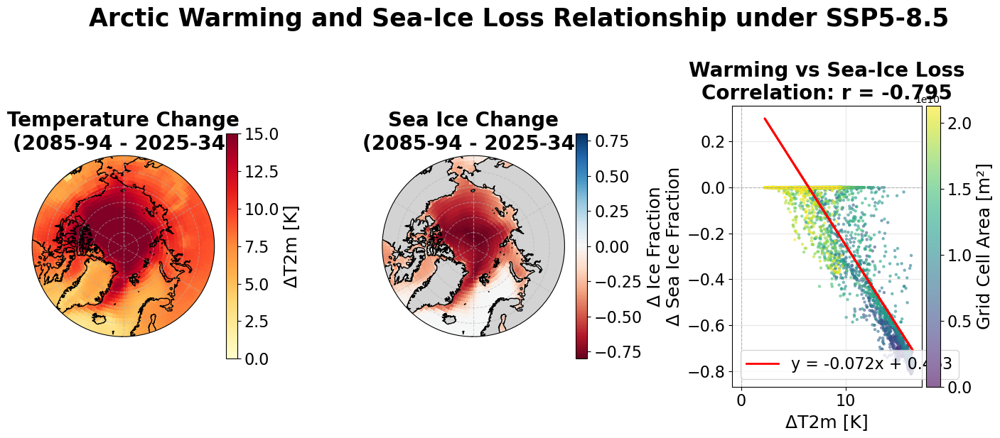


QUANTITATIVE ANALYSIS RESULTS
Weighted Correlation: r = -0.7954
Linear Fit: Δsicf = -0.0716 × ΔT2m + 0.4627
Interpretation: 0.0716 ice fraction loss per 1 K warming
Mean warming: 8.93 K
Mean ice loss: -0.158



In [ ]:
# ============================================================
# QUANTITATIVE LINK: WARMING vs SEA-ICE LOSS
# ============================================================

# Helper function to compute grid cell areas
def compute_grid_cell_areas(data_array):
    """Compute area of each grid cell in m²."""
    R = 6371000  # Earth radius in meters
    lats = data_array.lat.values
    lons = data_array.lon.values
    dlat = np.deg2rad(np.abs(np.diff(lats).mean()))
    dlon = np.deg2rad(np.abs(np.diff(lons).mean()))
    lat_2d, lon_2d = np.meshgrid(lats, lons, indexing='ij')
    lat_rad = np.deg2rad(lat_2d)
    areas = R**2 * np.cos(lat_rad) * dlat * dlon
    return xr.DataArray(areas, coords={'lat': lats, 'lon': lons}, dims=['lat', 'lon'])

# Compute temporal trends (2085-94 minus 2025-34) for SSP5-8.5
delta_t2m = ssp585_ar_85_94['t2m'].mean(dim='time') - ssp585_ar_25_34['t2m'].mean(dim='time')
delta_sicf = ssp585_ar_85_94['sicf'].mean(dim='time') - ssp585_ar_25_34['sicf'].mean(dim='time')

# Get areas for weighting
areas = compute_grid_cell_areas(delta_t2m)

# Flatten for scatter plot (only ocean points where sea ice can exist)
mask = ~np.isnan(delta_sicf.values)  # Valid sea ice points
t2m_flat = delta_t2m.values[mask]
sicf_flat = delta_sicf.values[mask]
areas_flat = areas.values[mask]

# Compute weighted correlation
weights_norm = areas_flat / areas_flat.sum()
t2m_weighted_mean = np.average(t2m_flat, weights=weights_norm)
sicf_weighted_mean = np.average(sicf_flat, weights=weights_norm)

cov = np.average((t2m_flat - t2m_weighted_mean) * (sicf_flat - sicf_weighted_mean), weights=weights_norm)
t2m_std = np.sqrt(np.average((t2m_flat - t2m_weighted_mean)**2, weights=weights_norm))
sicf_std = np.sqrt(np.average((sicf_flat - sicf_weighted_mean)**2, weights=weights_norm))
weighted_corr = cov / (t2m_std * sicf_std)

# Linear regression (weighted) - using np.polyfit with weights
try:
    # Use np.polyfit which is more robust
    coeffs = np.polyfit(t2m_flat, sicf_flat, deg=1, w=np.sqrt(weights_norm))
    slope, intercept = coeffs[0], coeffs[1]
except:
    # Fallback: simple unweighted regression if weighted fails
    from scipy import stats
    slope, intercept, r_value, p_value, std_err = stats.linregress(t2m_flat, sicf_flat)
    print("Warning: Using unweighted regression due to convergence issues")

# Create figure with 3 panels
fig = plt.figure(figsize=(20, 6))

# Panel 1: Δt2m map
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

ax1 = fig.add_subplot(1, 3, 1, projection=ccrs.NorthPolarStereo())
ax1.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
c1 = ax1.pcolormesh(delta_t2m.lon, delta_t2m.lat, delta_t2m,
                     transform=ccrs.PlateCarree(),
                     cmap='YlOrRd', vmin=0, vmax=15)
ax1.coastlines()
ax1.gridlines(linestyle='--', alpha=0.5)
ax1.set_boundary(map_circle, transform=ax1.transAxes)
cbar1 = plt.colorbar(c1, ax=ax1, shrink=0.8, pad=0.05)
cbar1.set_label('ΔT2m [K]', fontsize=18)
cbar1.ax.tick_params(labelsize=16)
ax1.set_title('Temperature Change\n(2085-94 - 2025-34)', fontsize=20, fontweight='bold')

# Panel 2: Δsicf map
ax2 = fig.add_subplot(1, 3, 2, projection=ccrs.NorthPolarStereo())
ax2.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
c2 = ax2.pcolormesh(delta_sicf.lon, delta_sicf.lat, delta_sicf,
                     transform=ccrs.PlateCarree(),
                     cmap='RdBu', vmin=-0.8, vmax=0.8)
ax2.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
ax2.coastlines(zorder=3)
ax2.gridlines(linestyle='--', alpha=0.5)
ax2.set_boundary(map_circle, transform=ax2.transAxes)
cbar2 = plt.colorbar(c2, ax=ax2, shrink=0.8, pad=0.05)
cbar2.set_label('Δ Ice Fraction', fontsize=18)
cbar2.ax.tick_params(labelsize=16)
ax2.set_title('Sea Ice Change\n(2085-94 - 2025-34)', fontsize=20, fontweight='bold')

# Panel 3: Scatter plot with correlation
ax3 = fig.add_subplot(1, 3, 3)
scatter = ax3.scatter(t2m_flat, sicf_flat, c=areas_flat, s=10, 
                      alpha=0.6, cmap='viridis', edgecolors='none')
ax3.plot(t2m_flat, slope * t2m_flat + intercept, 'r-', linewidth=2, 
         label=f'y = {slope:.3f}x + {intercept:.3f}')
ax3.axhline(0, color='gray', linestyle='--', linewidth=0.8, alpha=0.5)
ax3.axvline(0, color='gray', linestyle='--', linewidth=0.8, alpha=0.5)
ax3.set_xlabel('ΔT2m [K]', fontsize=18)
ax3.set_ylabel('Δ Sea Ice Fraction', fontsize=18)
ax3.set_title(f'Warming vs Sea-Ice Loss\nCorrelation: r = {weighted_corr:.3f}', 
              fontsize=20, fontweight='bold')
ax3.tick_params(axis='both', labelsize=16)
ax3.grid(True, alpha=0.3)
ax3.legend(loc='lower left', fontsize=16)
cbar3 = plt.colorbar(scatter, ax=ax3, pad=0.02)
cbar3.set_label('Grid Cell Area [m²]', fontsize=18)
cbar3.ax.tick_params(labelsize=16)

fig.suptitle('Arctic Warming and Sea-Ice Loss Relationship under SSP5-8.5', 
             fontsize=25, fontweight='bold', y=1.02)
plt.tight_layout()
#plt.savefig('figs_spacial/arctic_warming_seaice_correlation.png', dpi=150, bbox_inches='tight')
plt.show()

print(f"\n{'='*60}")
print(f"QUANTITATIVE ANALYSIS RESULTS")
print(f"{'='*60}")
print(f"Weighted Correlation: r = {weighted_corr:.4f}")
print(f"Linear Fit: Δsicf = {slope:.4f} × ΔT2m + {intercept:.4f}")
print(f"Interpretation: {abs(slope):.4f} ice fraction loss per 1 K warming")
print(f"Mean warming: {np.average(t2m_flat, weights=weights_norm):.2f} K")
print(f"Mean ice loss: {np.average(sicf_flat, weights=weights_norm):.3f}")
print(f"{'='*60}\n")

C:\Users\simon\AppData\Local\Temp\ipykernel_27924\3892738952.py:44: RuntimeWarning: invalid value encountered in sqrt
  coeffs = np.polyfit(t2m_flat, sicf_flat, deg=1, w=np.sqrt(weights_norm))


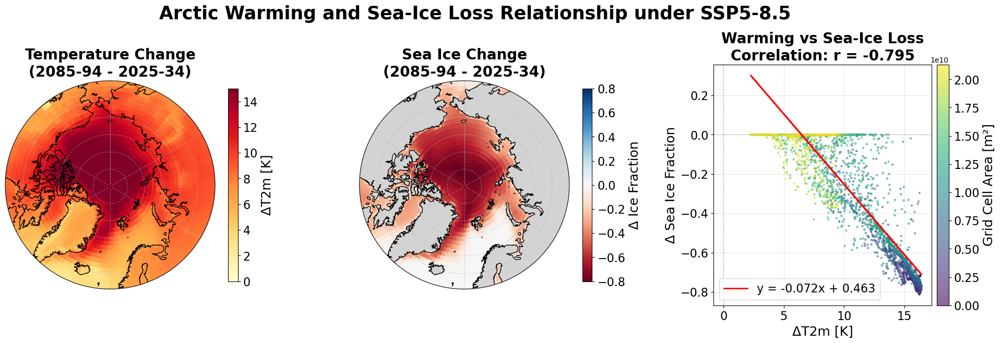


QUANTITATIVE ANALYSIS RESULTS
Weighted Correlation: r = -0.7954
Linear Fit: Δsicf = -0.0716 × ΔT2m + 0.4627
Interpretation: 0.0716 ice fraction loss per 1 K warming
Mean warming: 8.93 K
Mean ice loss: -0.158



In [50]:
# ============================================================
# QUANTITATIVE LINK: WARMING vs SEA-ICE LOSS
# ============================================================

# Helper function to compute grid cell areas
def compute_grid_cell_areas(data_array):
    """Compute area of each grid cell in m²."""
    R = 6371000  # Earth radius in meters
    lats = data_array.lat.values
    lons = data_array.lon.values
    dlat = np.deg2rad(np.abs(np.diff(lats).mean()))
    dlon = np.deg2rad(np.abs(np.diff(lons).mean()))
    lat_2d, lon_2d = np.meshgrid(lats, lons, indexing='ij')
    lat_rad = np.deg2rad(lat_2d)
    areas = R**2 * np.cos(lat_rad) * dlat * dlon
    return xr.DataArray(areas, coords={'lat': lats, 'lon': lons}, dims=['lat', 'lon'])

# Compute temporal trends (2085-94 minus 2025-34) for SSP5-8.5
delta_t2m = ssp585_ar_85_94['t2m'].mean(dim='time') - ssp585_ar_25_34['t2m'].mean(dim='time')
delta_sicf = ssp585_ar_85_94['sicf'].mean(dim='time') - ssp585_ar_25_34['sicf'].mean(dim='time')

# Get areas for weighting
areas = compute_grid_cell_areas(delta_t2m)

# Flatten for scatter plot (only ocean points where sea ice can exist)
mask = ~np.isnan(delta_sicf.values)  # Valid sea ice points
t2m_flat = delta_t2m.values[mask]
sicf_flat = delta_sicf.values[mask]
areas_flat = areas.values[mask]

# Compute weighted correlation
weights_norm = areas_flat / areas_flat.sum()
t2m_weighted_mean = np.average(t2m_flat, weights=weights_norm)
sicf_weighted_mean = np.average(sicf_flat, weights=weights_norm)

cov = np.average((t2m_flat - t2m_weighted_mean) * (sicf_flat - sicf_weighted_mean), weights=weights_norm)
t2m_std = np.sqrt(np.average((t2m_flat - t2m_weighted_mean)**2, weights=weights_norm))
sicf_std = np.sqrt(np.average((sicf_flat - sicf_weighted_mean)**2, weights=weights_norm))
weighted_corr = cov / (t2m_std * sicf_std)

# Linear regression (weighted) - using np.polyfit with weights
try:
    # Use np.polyfit which is more robust
    coeffs = np.polyfit(t2m_flat, sicf_flat, deg=1, w=np.sqrt(weights_norm))
    slope, intercept = coeffs[0], coeffs[1]
except:
    # Fallback: simple unweighted regression if weighted fails
    from scipy import stats
    slope, intercept, r_value, p_value, std_err = stats.linregress(t2m_flat, sicf_flat)
    print("Warning: Using unweighted regression due to convergence issues")

# Create figure with 3 panels - using GridSpec for better control
fig = plt.figure(figsize=(24, 6))
gs = fig.add_gridspec(1, 3, wspace=0.35, top=0.88)  # Added top parameter to leave room for main title

# Panel 1: Δt2m map
theta = np.linspace(0, 2*np.pi, 100)
map_circle = mpath.Path(np.vstack([np.sin(theta), np.cos(theta)]).T * 0.5 + [0.5, 0.5])

ax1 = fig.add_subplot(gs[0, 0], projection=ccrs.NorthPolarStereo())
ax1.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
c1 = ax1.pcolormesh(delta_t2m.lon, delta_t2m.lat, delta_t2m,
                     transform=ccrs.PlateCarree(),
                     cmap='YlOrRd', vmin=0, vmax=15)
ax1.coastlines()
ax1.gridlines(linestyle='--', alpha=0.5)
ax1.set_boundary(map_circle, transform=ax1.transAxes)
cbar1 = plt.colorbar(c1, ax=ax1, shrink=0.8, pad=0.05)
cbar1.set_label('ΔT2m [K]', fontsize=18)
cbar1.ax.tick_params(labelsize=16)
ax1.set_title('Temperature Change\n(2085-94 - 2025-34)', fontsize=20, fontweight='bold')

# Panel 2: Δsicf map
ax2 = fig.add_subplot(gs[0, 1], projection=ccrs.NorthPolarStereo())
ax2.set_extent([-180, 180, 60, 90], ccrs.PlateCarree())
c2 = ax2.pcolormesh(delta_sicf.lon, delta_sicf.lat, delta_sicf,
                     transform=ccrs.PlateCarree(),
                     cmap='RdBu', vmin=-0.8, vmax=0.8)
ax2.add_feature(cfeature.LAND, facecolor='lightgray', edgecolor='none', zorder=2)
ax2.coastlines(zorder=3)
ax2.gridlines(linestyle='--', alpha=0.5)
ax2.set_boundary(map_circle, transform=ax2.transAxes)
cbar2 = plt.colorbar(c2, ax=ax2, shrink=0.8, pad=0.05)
cbar2.set_label('Δ Ice Fraction', fontsize=18)
cbar2.ax.tick_params(labelsize=16)
ax2.set_title('Sea Ice Change\n(2085-94 - 2025-34)', fontsize=20, fontweight='bold')

# Panel 3: Scatter plot with correlation
ax3 = fig.add_subplot(gs[0, 2])
scatter = ax3.scatter(t2m_flat, sicf_flat, c=areas_flat, s=10, 
                      alpha=0.6, cmap='viridis', edgecolors='none')
ax3.plot(t2m_flat, slope * t2m_flat + intercept, 'r-', linewidth=2, 
         label=f'y = {slope:.3f}x + {intercept:.3f}')
ax3.axhline(0, color='gray', linestyle='--', linewidth=0.8, alpha=0.5)
ax3.axvline(0, color='gray', linestyle='--', linewidth=0.8, alpha=0.5)
ax3.set_xlabel('ΔT2m [K]', fontsize=18)
ax3.set_ylabel('Δ Sea Ice Fraction', fontsize=18)
ax3.set_title(f'Warming vs Sea-Ice Loss\nCorrelation: r = {weighted_corr:.3f}', 
              fontsize=20, fontweight='bold')
ax3.tick_params(axis='both', labelsize=16)
ax3.grid(True, alpha=0.3)
ax3.legend(loc='lower left', fontsize=16)
cbar3 = plt.colorbar(scatter, ax=ax3, pad=0.02)
cbar3.set_label('Grid Cell Area [m²]', fontsize=18)
cbar3.ax.tick_params(labelsize=16)

fig.suptitle('Arctic Warming and Sea-Ice Loss Relationship under SSP5-8.5', 
             fontsize=25, fontweight='bold', y=1.07)  # Adjusted y position
#plt.savefig('figs_spacial/arctic_warming_seaice_correlation.png', dpi=150, bbox_inches='tight')
plt.show()

print(f"\n{'='*60}")
print(f"QUANTITATIVE ANALYSIS RESULTS")
print(f"{'='*60}")
print(f"Weighted Correlation: r = {weighted_corr:.4f}")
print(f"Linear Fit: Δsicf = {slope:.4f} × ΔT2m + {intercept:.4f}")
print(f"Interpretation: {abs(slope):.4f} ice fraction loss per 1 K warming")
print(f"Mean warming: {np.average(t2m_flat, weights=weights_norm):.2f} K")
print(f"Mean ice loss: {np.average(sicf_flat, weights=weights_norm):.3f}")
print(f"{'='*60}\n")